In [2]:
import sys
import xarray as xr
import glob
import dask
import cartopy.crs as ccrs
import cmocean
import matplotlib.pyplot as plt
import re
import datetime
from functions.grid_to_km import area
import cartopy
import cartopy.crs as ccrs
import matplotlib as mpl
import numpy as np
from scipy.sparse import csr_matrix
import scipy.sparse.linalg as sla
import matplotlib.animation as animation
from matplotlib import rc
import glob
import IPython
from IPython.display import HTML
from timeit import default_timer as timer



In [3]:
sys.path.insert(0,'.')    # '.' is in the same folder
%load_ext autoreload
%autoreload 1
#  Reload all modules imported with %aimport every time before executing the Python code typed.

# %cd /home/students/6252699/thesis/parcels2/
%aimport advect_ice
%aimport plot_functions
%aimport transition_matrices

%matplotlib inline

import functions.lay_out


In [4]:
fig_dir = "/home/students/6252699/thesis/parcels2/figures/"
out_dir = "/scratch/AnnekeV/output/"

In [5]:
plt.style.use(['default'])


def set_axes():
    plt.figure(figsize = [8,8])
    ax = plt.axes(projection=ccrs.NorthPolarStereo())
    ax.gridlines(xlocs = np.arange(-180,185,20), ylocs = np.arange(-90, 95,5), color='black', alpha=0.5, linestyle=':')
    ax.add_feature(cartopy.feature.OCEAN)
    ax.add_feature(cartopy.feature.LAND)
    ax.set_extent([-180,180,50,90],  ccrs.PlateCarree())
    ax.coastlines()
    ax.stock_img()
    return ax

In [6]:
# output_name = advect_ice.run_experiment(start_date='2014-02-01' ,  custom_kernel = "AdvectionRK4_prob", simdays=60) 

============================================================================================================================================================================
# 18 maart (zie boekje runs 13 maart)
============================================================================================================================================================================

In [261]:
names_13_march = sorted(glob.glob("/scratch/AnnekeV/output/bigrun/03-13*.nc"))
names_13_march_2016 = sorted(glob.glob("/scratch/AnnekeV/output/bigrun/03-13*2016*.nc"))
names_summer = sorted(glob.glob("/scratch/AnnekeV/output/bigrun/*summer*.nc"))
names_13_march_2014_ice = sorted(glob.glob("/scratch/AnnekeV/output/bigrun/03-13*2014*prob.nc"))
names_13_march_2015_ice = sorted(glob.glob("/scratch/AnnekeV/output/bigrun/03-13*2015*prob.nc"))
names_13_march_2016_ice = sorted(glob.glob("/scratch/AnnekeV/output/bigrun/03-13*2016*prob.nc"))



In [16]:
def prop_from_name(name): 

    test_sep     = name.split('_')
    run_date     = test_sep[0].split('bigrun/')[1]
    npart        = test_sep[2]
    start_date   = test_sep[4]
    simdays      = test_sep[6]
    kernel       = (test_sep[-2] + test_sep[-1]).split('.')[0]
    
    
    print('The run date is {}'.format(run_date))
    print('N. particles :  {}'.format(npart))
    print('Starting date : {}'.format(start_date))
    print('Simulated days: {}'.format(simdays))
    print('Kernel used:    {}'.format(kernel))
    print('\n')
    return start_date, simdays, kernel


## do test with runtimes 

In [378]:
runtimes = []
resolutions = [10,5,2,1,.5]

for res in resolutions:
    print("{}\n".format(res))
    start = timer()
    _, _, _, _ = transition_matrices.trans_mat_digit(names_13_march[0], res, final_index =-1, in_ice = False, void = True)
    end   = timer()
    runtimes.append(end-start)

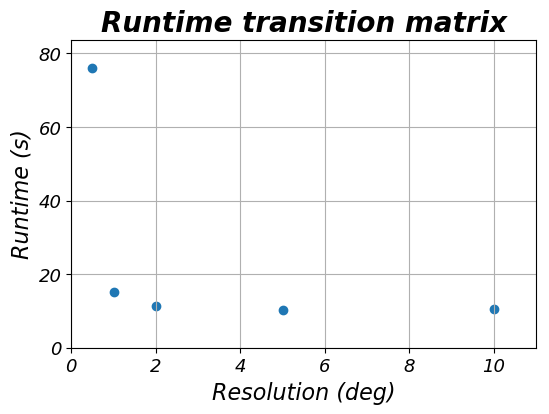

In [77]:
plt.figure(figsize=[6,4])
plt.scatter(resolutions,  runtimes)
plt.xlabel("Resolution (deg)")
plt.ylabel("Runtime (s)")
plt.xlim([0,np.max(resolutions)*1.1])
plt.ylim([0,np.max(runtimes)*1.1])
plt.title("Runtime transition matrix")
# plt.savefig(fig_dir + "/transitionplots/runtime.png")

# eigen vector per file

In [389]:
i = -1
run_prop = run(names_13_march[i])
title = "{}, {} simdays, {}".format(run_prop.start_date,run_prop.simdays, run_prop.kernel)
T, latbins, lonbins, M = transition_matrices.trans_mat_digit(names_13_march[i], res=1., final_index =-1, in_ice = False, void = True)



k = 15
nlat, nlon = len(latbins)-1, len(lonbins)-1
ncels      = nlat*nlon
# eig_val_l, eig_vec_l = sla.eigs(M.transpose(), k = k, which = 'LM')
eig_val_r, eig_vec_r = sla.eigs(M, k = k, which = 'LM')


The run date is 03-13
N. particles :  487787
Starting date : 2014-02-11
Simulated days: 40
Kernel used:    AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T


In [56]:
sumt = np.sum(T, axis = 0)

In [61]:
np.any(sumt[sumt<1-10e-9])

False

In [396]:
np.mean(abs(eig_vec_r))

0.0002189051547005969

# transition multiplication per file

The run date is 03-13
N. particles :  487792
Starting date : 2015-02-11
Simulated days: 40
Kernel used:    AdvectionRK4prob




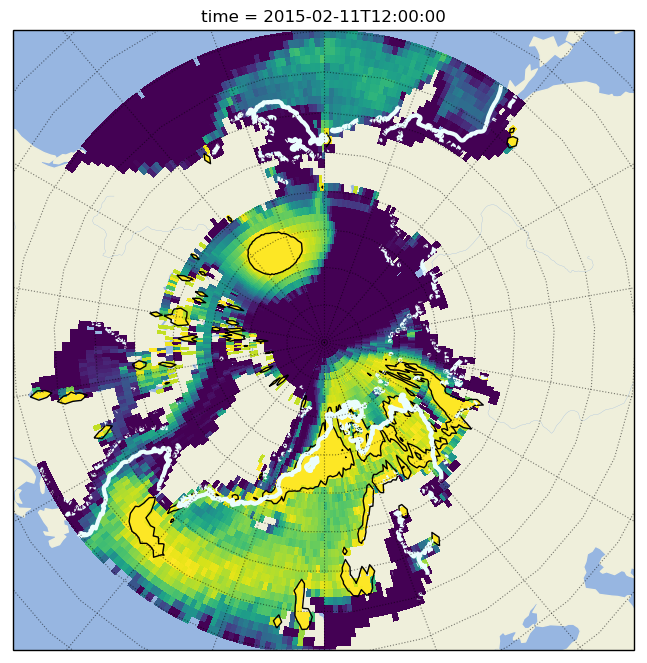

In [87]:
res    = 1.   # degrees
length = 2400 # days

for i in [-1]:

#     T, latbins, lonbins, M = transition_matrices.trans_mat_digit(names_13_march[i], res=res, final_index =-1, in_ice = False, void = True)
    date, days, kernel = prop_from_name(names_13_march[i])
    times = length//eval(days)
    title = "{}, {} simdays, {}".format(date,days, kernel)
    ax = transition_matrices.movement(M,latbins, lonbins, times=times,  grid_plot = False, title = title, savefig = False, save_name="")
#     plt.savefig(fig_dir + "transitionplots/03_18/single_plot_2400_days_{}_{}_{}.png".format(date,days,kernel), bbox_inches="tight", pad_inches=0.1)
    extentdate = datetime.datetime.strptime("2015-02-11", "%Y-%m-%d").date()
    plot_extent(extentdate, ax)
    plt.show()


# FOR THE SUMMER

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487791
Starting date : 2014-08-11
Simulated days: 40
Kernel used:    AdvectionRK4ocean




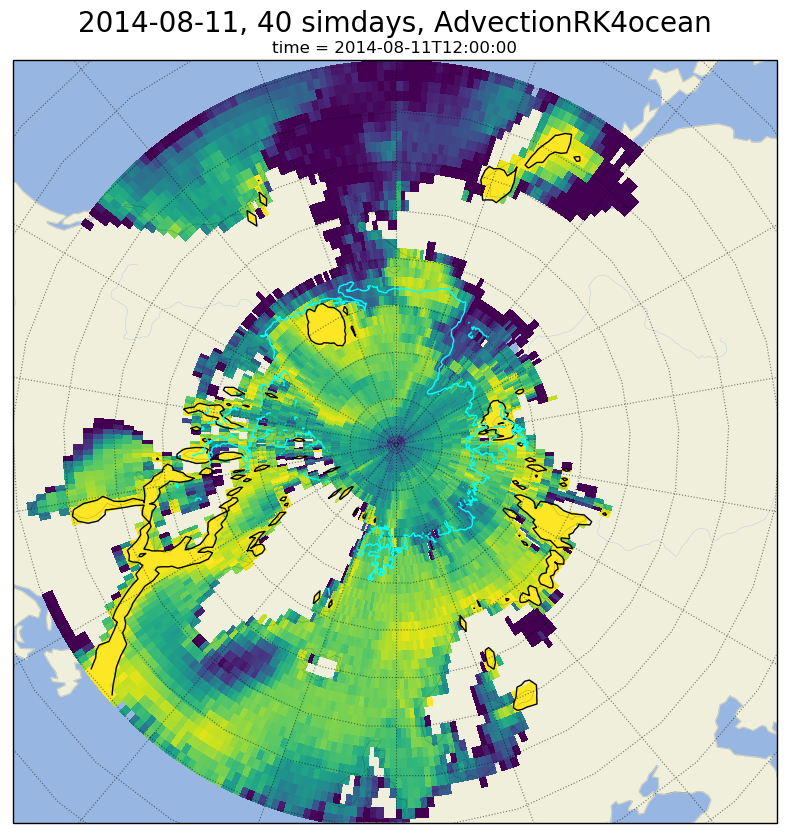

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487791
Starting date : 2015-08-21
Simulated days: 20
Kernel used:    AdvectionRK4ocean




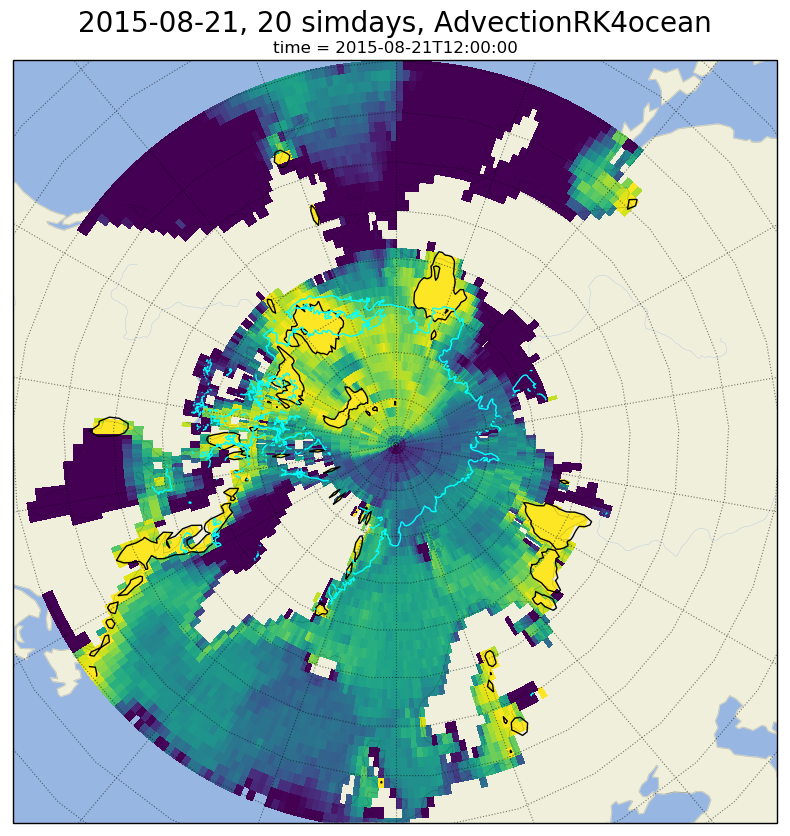

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2014-08-01
Simulated days: 60
Kernel used:    AdvectionRK4ocean




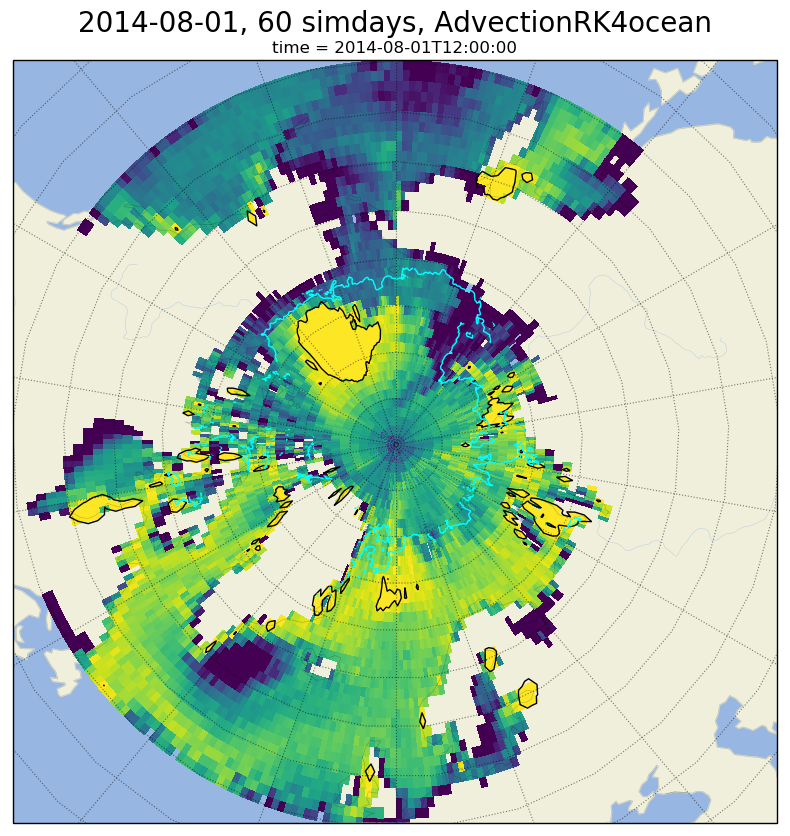

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2014-08-21
Simulated days: 20
Kernel used:    AdvectionRK4ocean




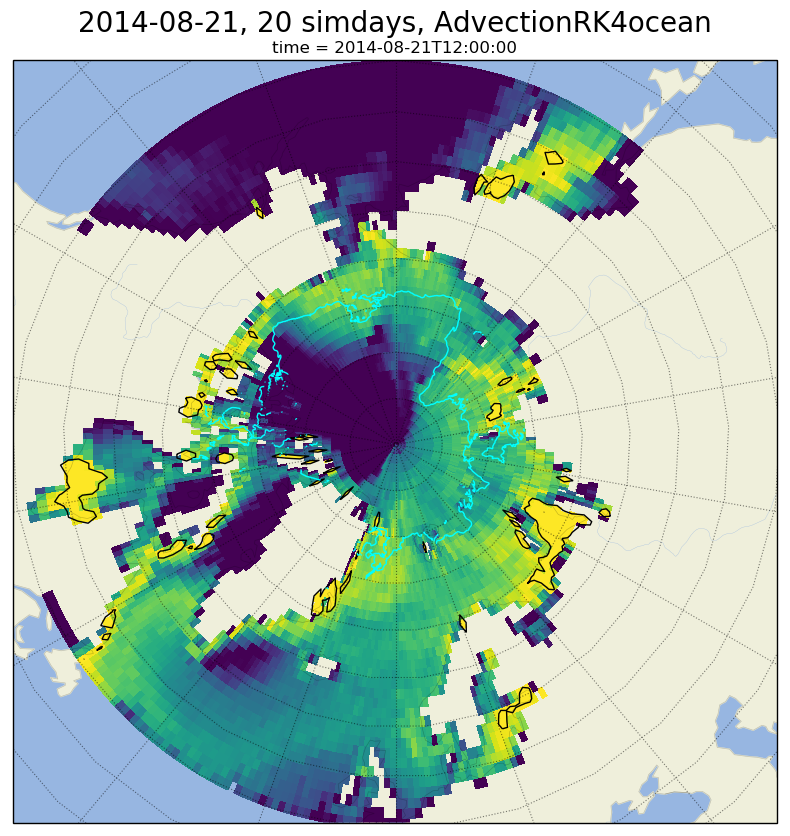

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2015-08-01
Simulated days: 60
Kernel used:    AdvectionRK4ocean




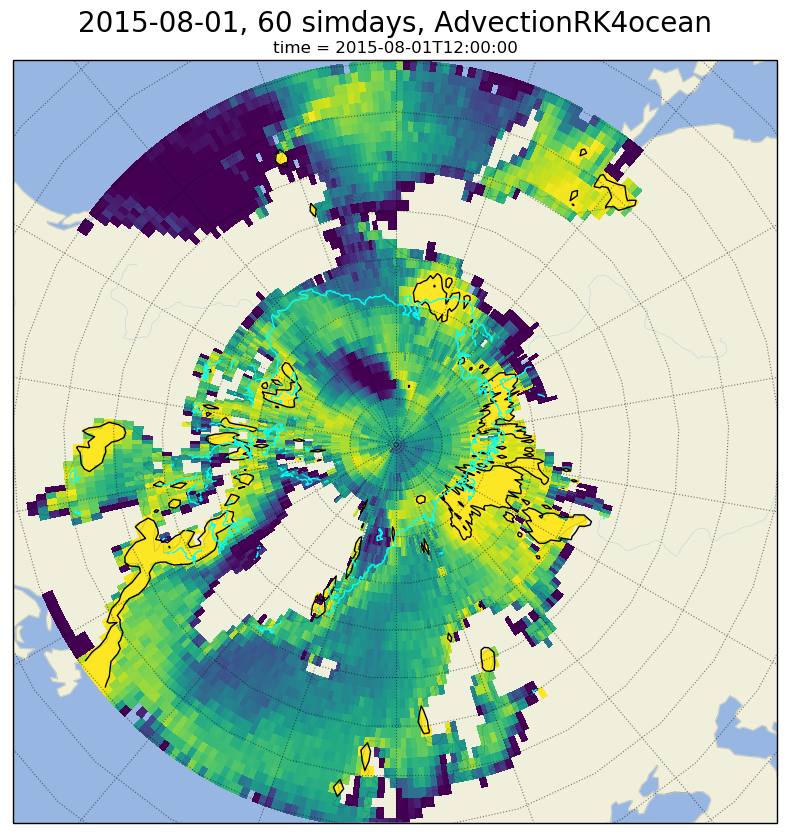

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2015-08-11
Simulated days: 40
Kernel used:    AdvectionRK4ocean




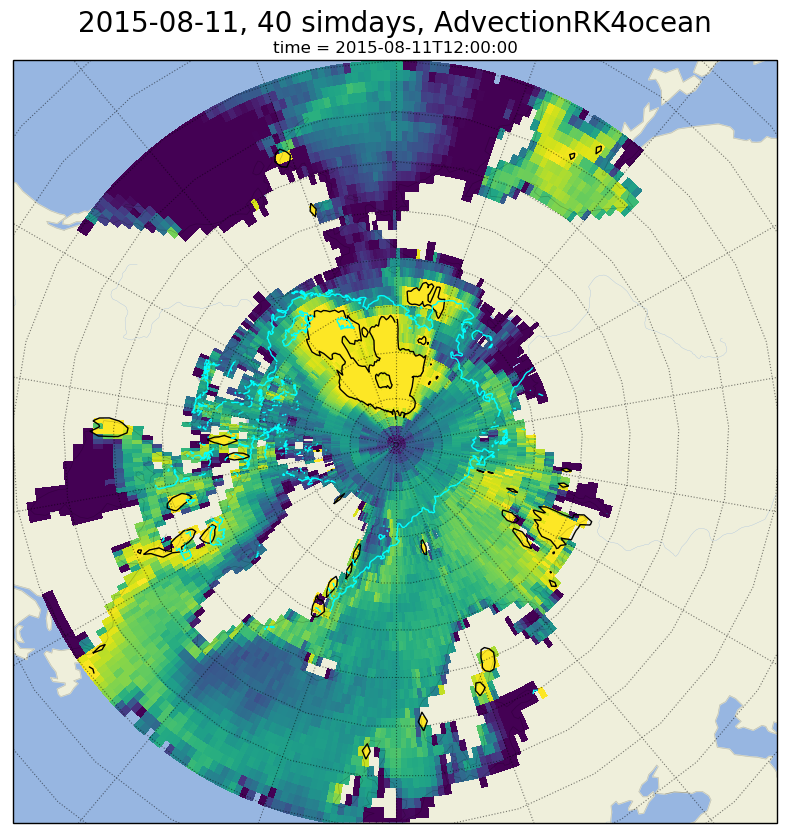

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2016-08-01
Simulated days: 60
Kernel used:    AdvectionRK4ocean




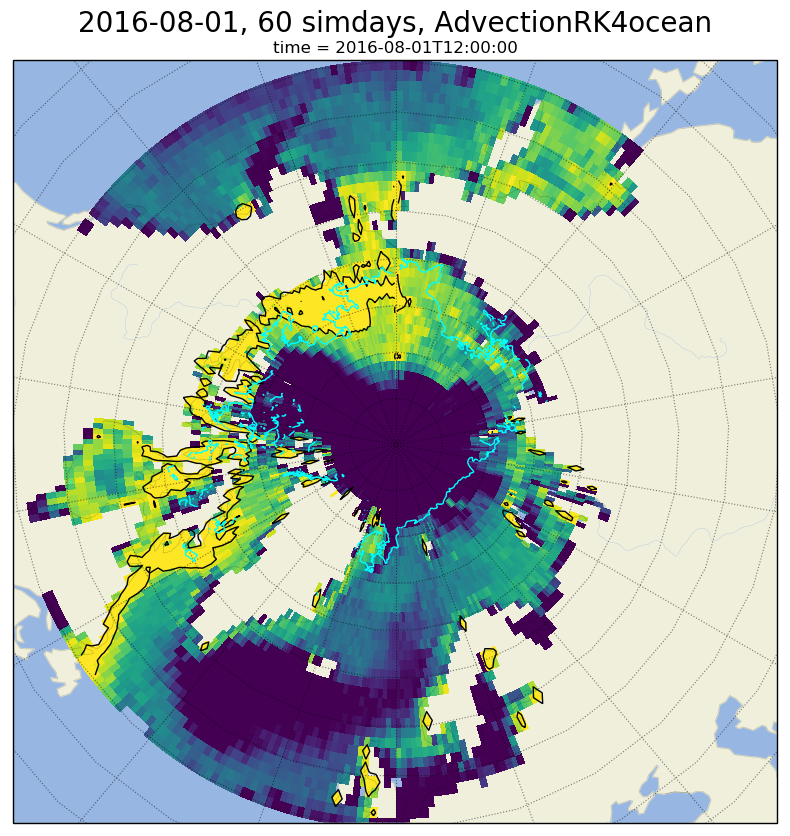

Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2016-08-11
Simulated days: 40
Kernel used:    AdvectionRK4ocean




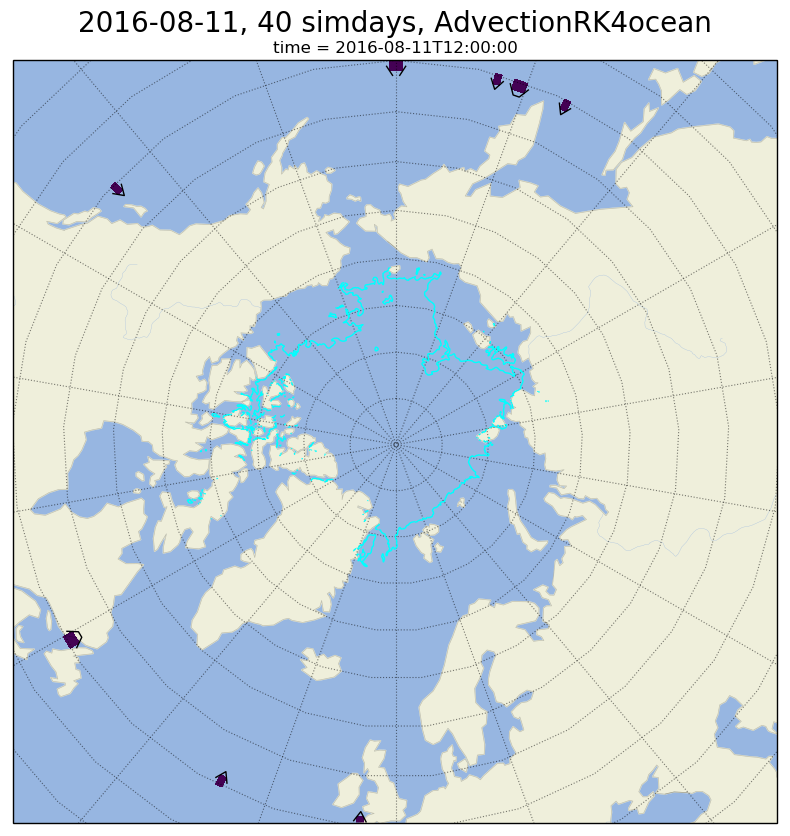

In [274]:
res    = 1.   # degrees
length = 2400 # days

FILES = names_summer

for i in range(len(FILES)):
    T, latbins, lonbins, M = transition_matrices.trans_mat_digit(FILES[i], res=res, final_index =-1, in_ice = False, void = True)
    date, days, kernel = prop_from_name(FILES[i])
    times = length//eval(days)
    title = "{}, {} simdays, {}".format(date,days, kernel)
    ax = transition_matrices.movement(M,latbins, lonbins, times=times,  grid_plot = False, title = title, savefig = False, save_name="")
    plt.savefig(fig_dir + "transitionplots/03_28/single_plot_summer__2400_days_{}_{}_{}.png".format(date,days,kernel), bbox_inches="tight", pad_inches=0.1)
    extentdate = datetime.datetime.strptime(date, "%Y-%m-%d").date()
    plot_extent(extentdate, ax)
    plt.tight_layout()
    plt.show()


Opened dataset
Made transition matrix
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2016-08-11
Simulated days: 40
Kernel used:    AdvectionRK4ocean




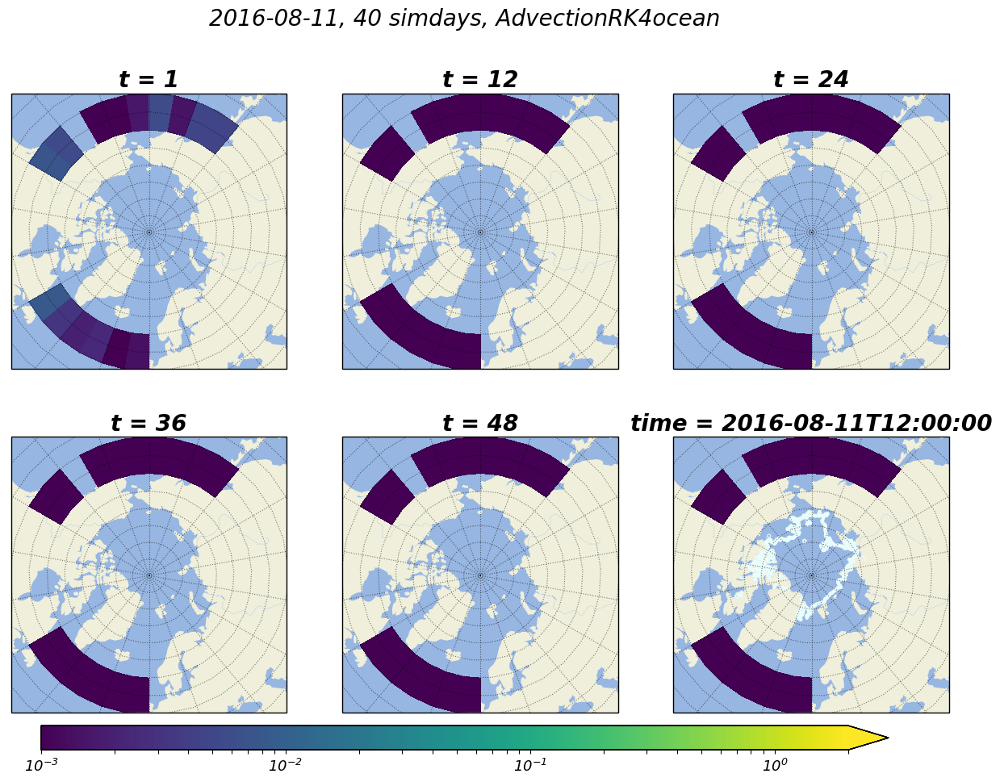

In [111]:
res    = 10.   # degrees
length = 2400 # days

FILES = names_summer

for i in [-1]:
    T, latbins, lonbins, M = transition_matrices.trans_mat_digit(FILES[i], res=res, final_index =-1, in_ice = False, void = False, sink = False)
    date, days, kernel = prop_from_name(FILES[i])
    times = length//eval(days)
    title = "{}, {} simdays, {}".format(date,days, kernel)
    ax = transition_matrices.movement(M,latbins, lonbins, times=times,  grid_plot = True, title = title, savefig = False, save_name="")
#     plt.savefig(fig_dir + "transitionplots/03_28/single_plot_summer_2400_days_{}_{}_{}.png".format(date,days,kernel), bbox_inches="tight", pad_inches=0.1)
    extentdate = datetime.datetime.strptime(date, "%Y-%m-%d").date()
    plot_extent(extentdate, ax)
    plt.show()

Opened dataset
Made transition matrix
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2016-08-01
Simulated days: 60
Kernel used:    AdvectionRK4ocean


Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-19-summer
N. particles :  487792
Starting date : 2016-08-01
Simulated days: 60
Kernel used:    AdvectionRK4ocean




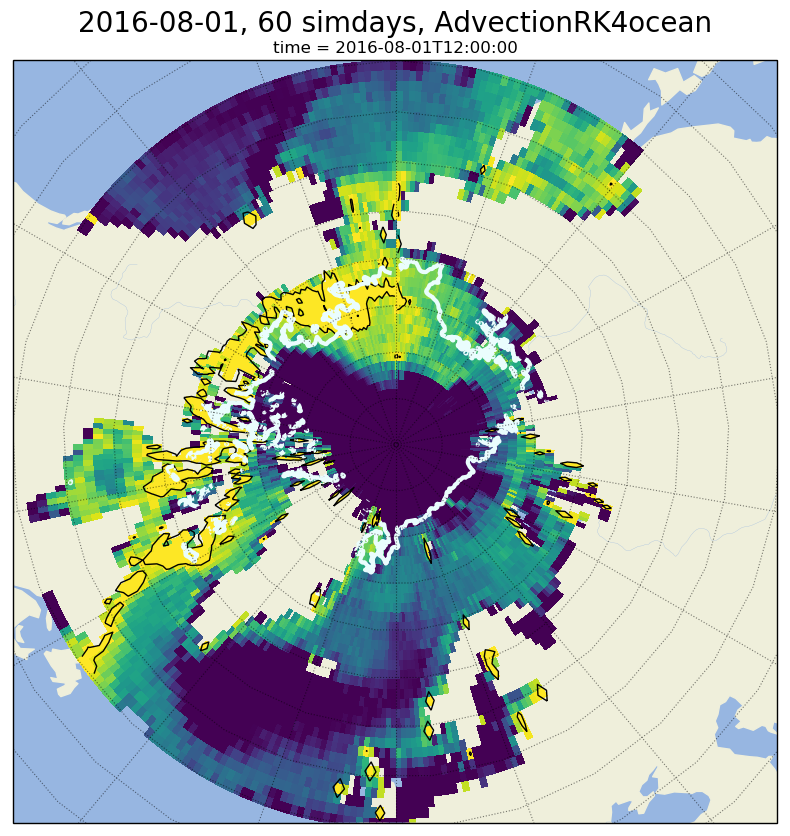

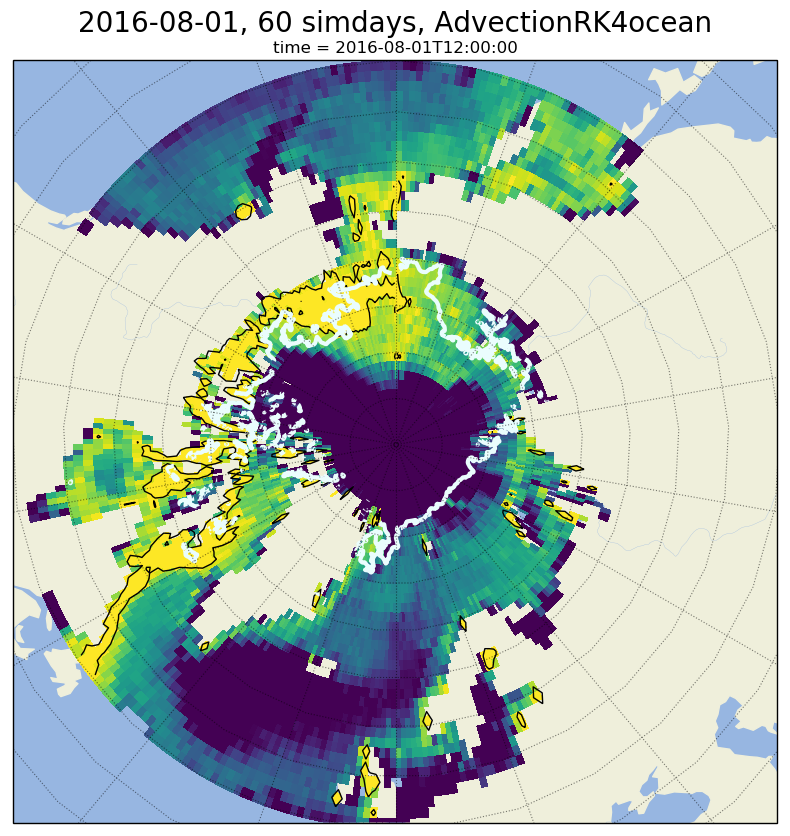

In [94]:
#Not really a difference between having a sink and having no sink


res    = 1.   # degrees
length = 2400 # days

FILES = names_summer

for i in [-2]:
    T, latbins, lonbins, M = transition_matrices.trans_mat_digit(FILES[i], res=res, final_index =-1, in_ice = False, void = False, sink = False)
    date, days, kernel = prop_from_name(FILES[i])
    times = length//eval(days)
    title = "{}, {} simdays, {}".format(date,days, kernel)
    ax = transition_matrices.movement(M,latbins, lonbins, times=times,  grid_plot = False, title = title, savefig = False, save_name="")
#     plt.savefig(fig_dir + "transitionplots/03_28/single_plot_summer_2400_days_{}_{}_{}.png".format(date,days,kernel), bbox_inches="tight", pad_inches=0.1)
    extentdate = datetime.datetime.strptime(date, "%Y-%m-%d").date()
    plot_extent(extentdate, ax)
    plt.tight_layout()
    
#     plt.show()
for i in [-2]:
    T, latbins, lonbins, M = transition_matrices.trans_mat_digit(FILES[i], res=res, final_index =-1, in_ice = False, void = True, sink = True)
    date, days, kernel = prop_from_name(FILES[i])
    times = length//eval(days)
    title = "{}, {} simdays, {}".format(date,days, kernel)
    ax = transition_matrices.movement(M,latbins, lonbins, times=times,  grid_plot = False, title = title, savefig = False, save_name="")
#     plt.savefig(fig_dir + "transitionplots/03_28/single_plot_summer_2400_days_{}_{}_{}.png".format(date,days,kernel), bbox_inches="tight", pad_inches=0.1)
    extentdate = datetime.datetime.strptime(date, "%Y-%m-%d").date()
    plot_extent(extentdate, ax)
    plt.tight_layout()
#     plt.show()


## Validation test

### Particles per bin

In [208]:
def particles_per_bin(ds_name, res, final_index =-1, in_ice = False, void = True):
    '''
    Makes a transition matrix.
    ds_name = the name of the file (incl. direcotry)
    res     = resolution
    final_index in case you don't want it to be the last value
    ===============================================
    Returns Transition matrix, latbins, lonbins, sparse matrix
    '''
    
    ds = xr.open_dataset(ds_name, decode_times = False)

    N   = 360//res

    lons_i   = ds.lon.isel(obs= 0).values
    lats_i   = ds.lat.isel(obs= 0).values
    lons_f   = ds.lon.isel(obs= final_index).values
    lats_f   = ds.lat.isel(obs= final_index).values
    
    print("Opened dataset")
    
    nparts              = len(lons_i)
    particle_grid_index = np.zeros((2, nparts), dtype=int)
    ncels               = int ((360//res) * (40//res))

    if in_ice:
        in_ice_i = ds.in_ice.isel(obs=0).values  
        in_ice_f = ds.in_ice.isel(obs=final_index).values
        T        = np.zeros((ncels*2+1,ncels*2+1))
        
    else:
        in_ice_i = np.zeros(np.shape(lons_i))
        in_ice_f = np.zeros(np.shape(lons_i))
        T        = np.zeros((ncels+1,ncels+1))

    
    '''Find initial indices'''
    for i in range(nparts):
        if np.isnan(lons_i[i]) or np.isnan(lats_i[i]) :
            particle_grid_index[0,i] = -1
        else:
            particle_grid_index[0,i] = int((lats_i[i]-50)//res)*N  + int((lons_i[i]+ 180)//res) + int(in_ice_i[i]) * ncels

    '''Find final indices'''
    for i in range(nparts):
        if np.isnan(lons_f[i]) or np.isnan(lats_f[i]):
            particle_grid_index[1,i] = -1
        else:
            particle_grid_index[1,i] = int((lats_f[i]-50)//res)*N  + int((lons_f[i]+ 180)//res) + int(in_ice_f[i]) * ncels

    for i in range(nparts):
        T[particle_grid_index[1,i], particle_grid_index[0,i]] += 1

    
    print("Made transition matrix")
    '''Normalize matrix'''
#     sumT =  np.sum(T, axis=0)
#     sumT[sumT ==0] = 1
#     T /=sumT

    '''Remove sinks'''
    max_sink = (np.diag(T)[:-1]).max()
    count    = 0
    while (max_sink == 1 and count <10):
        T        = remove_sinks(T)
        count   += 1
        max_sink = (np.diag(T)[:-1]).max()
    print ("Count removal for sinks is {}" .format(count))
    
    T[:,-1]  = 0   # all nan's go to nan
    T[-1,-1] = 1

    latbins, lonbins= np.arange(50,90+res, res),  np.arange(-180,180+res, res)  
    
    
    if void: 
        zeros = np.where(T.sum(axis=0)==0)
        Tkopy = T[:,:]
        Tkopy[zeros,:] = 0 
        sumTkopy =  np.sum(Tkopy, axis=0)
        sumTkopy[sumTkopy ==0] = 1.
#         Tkopy = Tkopy/sumTkopy
        T = Tkopy[:,:]
        
        
    M_sparse = csr_matrix(T)
    print("Done with T")
    
    return T

0 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
8 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
17 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
25 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
33 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
42 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
50 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
58 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
67 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
75 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
83 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done with T
92 %
Opened dataset
Made transition matrix
Count removal for sinks is 0
Done w

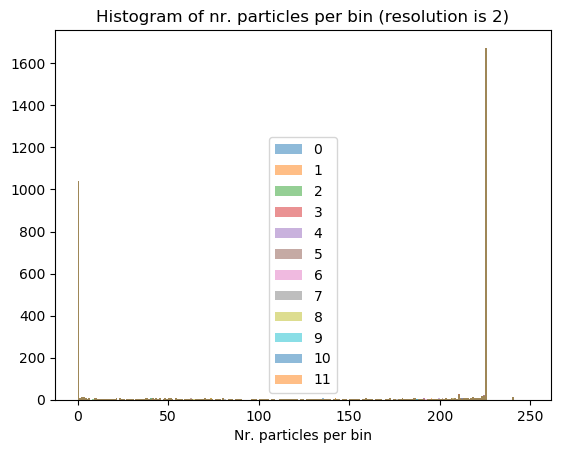

In [291]:
sumT= []
for i in range(12):
    print("{:.0f} %".format(i/12.*100.))
    T = particles_per_bin(names_13_march[i], res=2., final_index =-1, in_ice = False, void = True)
    sumT.extend(np.sum(T, axis=0))

    

plt.hist(sumT, bins = np.arange(250))
plt.title("Histogram of nr. particles per bin (resolution is 2)")
plt.xlabel("Nr. particles per bin")
# plt.savefig(fig_dir+ "/transitionplots/03_18/histogram_per_bin_total_res_2.png")

    

### Mass conservation

In [292]:

def calculate_R(M,latbins, lonbins, grid_plot, times=5, title = "",  savefig = False, save_name=""):
    '''
    Plot the results form the multiplication of the transitionmatir with the tracer
    T is the sparse eigenvector
    '''
    nlat     = len(latbins)-1
    nlon     = len(lonbins)-1
    ncels    = nlat*nlon
    res      = latbins[1]-latbins[0]

    R        = np.zeros((times, ncels+1))
    R[0,:]   = 1.

    for t in range(1,times):
         R[t,:] = M.dot(R[t-1,:])
            
    return R

0 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
8 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
17 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
25 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
33 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
42 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
50 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
58 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
67 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
75 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
83 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
92 %
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done w

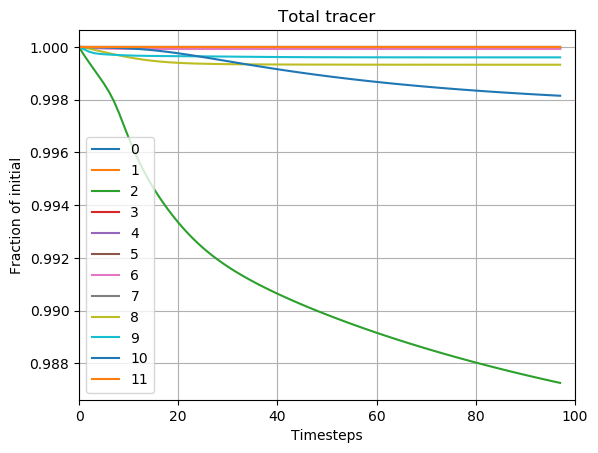

In [349]:

import functions.lay_out

fig = plt.figure()
times = 100


for i in range(12):
    print("{:.0f} %".format(i/12.*100.))
    T, latbins, lonbins, M = transition_matrices.trans_mat_digit(names_13_march[i], res=1., final_index =-1, in_ice = False, void = True)
    R = calculate_R(M,latbins, lonbins, times=times,  grid_plot = False, title = title, savefig = False, save_name="")
    Rsum = np.sum(R, axis = 1)[1:]
    plt.plot(Rsum[1:]/Rsum[1], label = "{}".format(i))

plt.title("Total tracer")
plt.legend()
plt.grid(b = True)
# plt.ylim([0.99,1.01])
plt.xlim([0,100])
plt.xlabel("Timesteps")
plt.ylabel("Fraction of initial")
plt.savefig(fig_dir + "transitionplots/03_18/decrease_in_tracer.png")

In [346]:
zeros = np.where(T.sum(axis=0)==0)[0]
Tkopy = T[:,:]
Tkopy[zeros,:] = 0 
sumTkopy =  np.sum(Tkopy, axis=0)
sumTkopy[sumTkopy ==0] = 1.
Tkopy = Tkopy/sumTkopy
T = Tkopy[:,:]

zeros = np.where(T.sum(axis=0)==0)[0]
Tkopy = T[:,:]
Tkopy[zeros,:]# = 0 
np.where(Tkopy[zeros,:]>0)        

(array([], dtype=int64), array([], dtype=int64))

In [ ]:
for stringdate in ['2014-02-01','2014-03-01','2014-04-01', '2015-02-01','2015-03-01','2015-04-01']:
    date = datetime.datetime.strptime(stringdate, "%Y-%m-%d").date()
    ax   = plot_functions.set_axes()
    plot_functions.plot_extent( date=date, ax=ax)


============================================================================================================================================================================
# Seperate transition matrices
============================================================================================================================================================================

============================================================================================================================================================================
## 2016
============================================================================================================================================================================

In [ ]:
res    = 1.   # degrees
length = 2400 # days



nfiles = len(names_summer)

for i in range(nfiles):
    T, latbins, lonbins, M = transition_matrices.trans_mat_digit(names_summer[i], res=res, final_index =-1, in_ice = True, void = True)
    date, days, kernel = prop_from_name(names_summer[i])
    times = length//eval(days)
    title = "{}, {} simdays, {}".format(date,days, kernel)
    transition_matrices.movement(M,latbins, lonbins, times=times,  grid_plot = False, title = title, in_ice = True, savefig = False, save_name="")
#     plt.savefig(fig_dir + "transitionplots/03_25/seperate_ocean_ice_2400_days_{}_{}_{}.png".format(date,days,kernel), bbox_inches="tight", pad_inches=0.1)
    plt.show()


Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
The run date is 03-13
N. particles :  487787
Starting date : 2016-02-11
Simulated days: 40
Kernel used:    AdvectionRK4ocean




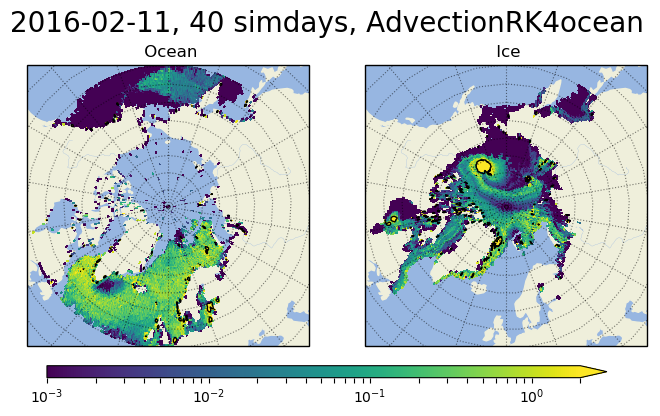

Opened dataset
Made transition matrix


MemoryError: 

In [52]:
res    = .5   # degrees
length = 2400 # days

nfiles = len(names_13_march_2016)

for i in range(nfiles):
    T, latbins, lonbins, M = transition_matrices.trans_mat_digit(names_13_march_2016[i], res=res, final_index =-1, in_ice = True, void = True)
    date, days, kernel = prop_from_name(names_13_march_2016[i])
    times = length//eval(days)
    title = "{}, {} simdays, {}".format(date,days, kernel)
    transition_matrices.movement(M,latbins, lonbins, times=times,  grid_plot = False, title = title, in_ice = True, savefig = False, save_name="")
    plt.savefig(fig_dir + "transitionplots/03_25/seperate_ocean_ice_2400_days_{}_{}_{}_{}.png".format(date,days,kernel, int(res*10)), bbox_inches="tight", pad_inches=0.1)
    plt.show()


============================================================================================================================================================================
# Seperate Straits
============================================================================================================================================================================

Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T


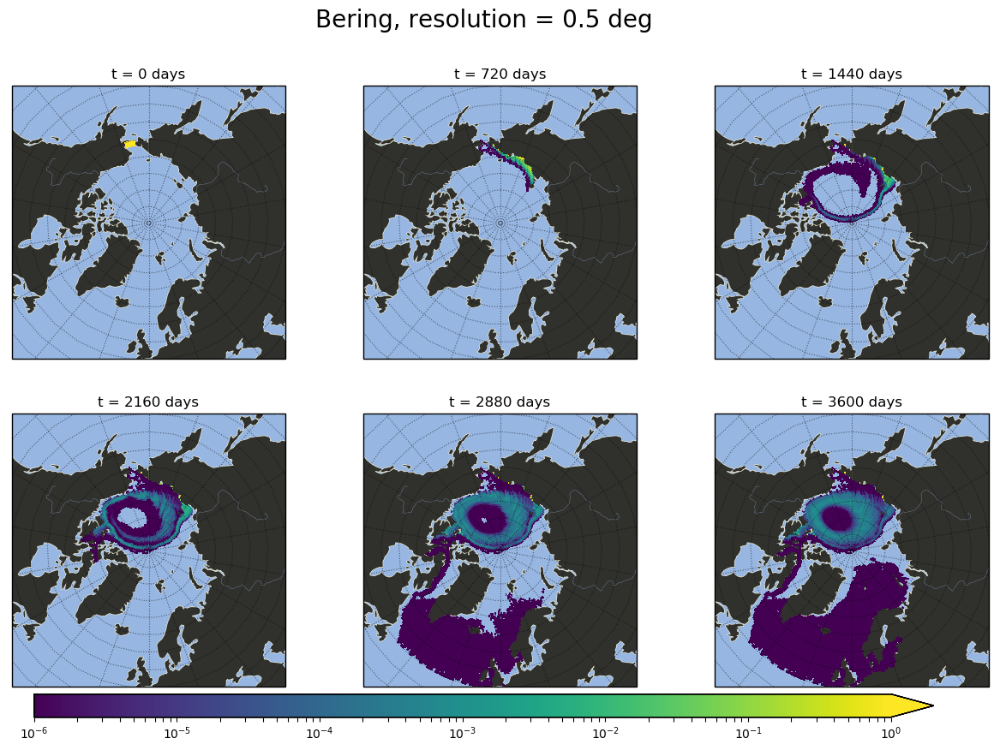

In [55]:
for res in [0.5]:
    T, latbins_bering, lonbins_bering, M_bering = transition_matrices.trans_mat_digit(names_13_march_2016[-1], res=res, final_index =-1, in_ice = False, void = True)
    days = 60 
    times = 61
    transition_matrices.movement_strait(M_bering,latbins_bering, lonbins_bering, days = days, times=times, strait = "Bering")
    plt.savefig(fig_dir + "transitionplots/03_25/bering_res_{}_days_{}.png".format(int(res*10), days*(times-1)))
    plt.show()


In [552]:
print(names_13_march_2016[-1])

/scratch/AnnekeV/output/bigrun/03-13_npart_487791_start_2016-02-01_simdays_60_kernel_AdvectionRK4_prob.nc


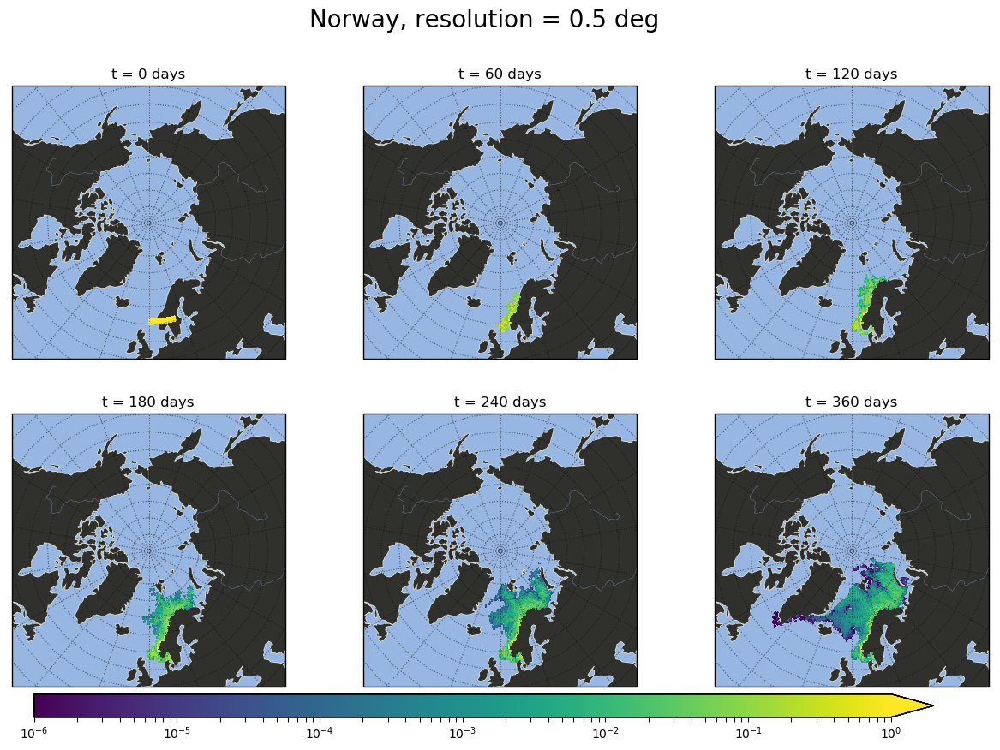

In [14]:
# for res in [1.0, 0.5]:
#     _, latbins_norway, lonbins_norway, M_norway = transition_matrices.trans_mat_digit(names_13_march_2016[-1], res=res, final_index =-1, in_ice = False, void = True)
transition_matrices.movement_strait(M_bering,latbins_bering, lonbins_bering, days = 60, times=7, strait = "Norway")
plt.savefig(fig_dir+ "transitionplots/03_25/Norway_res_0_5.png")
plt.show()

In [507]:
ds_name     = names_13_march_2016[-1]
res         = 1
final_index = -1
in_ice      = False
void        = True
# def trans_mat_digit(ds_name, res, final_index =-1, in_ice = False, void = True):
'''
Makes a transition matrix.
ds_name = the name of the file (incl. direcotry)
res     = resolution
final_index in case you don't want it to be the last value
===============================================
Returns Transition matrix, latbins, lonbins, sparse matrix
'''

ds = xr.open_dataset(ds_name, decode_times = False)

N   = 360//res

lons_i   = ds.lon.isel(obs= 0).values
lats_i   = ds.lat.isel(obs= 0).values
lons_f   = ds.lon.isel(obs= final_index).values
lats_f   = ds.lat.isel(obs= final_index).values

lons_af   = ds.lon.isel(obs= -2).values   #almost final
lats_af   = ds.lat.isel(obs= -2).values   #almost final

In [66]:
range(1)

[0]

In [520]:
print("Opened dataset")

nparts              = len(lons_i)
particle_grid_index = np.zeros((2, nparts), dtype=int)
ncels               = int ((360//res) * (40//res))
almost_zero         = 1e-5

if in_ice:
    in_ice_i = ds.in_ice.isel(obs=0).values  
    in_ice_f = ds.in_ice.isel(obs=final_index).values
    T        = np.zeros((ncels*2+1,ncels*2+1))

else:
    in_ice_i = np.zeros(np.shape(lons_i))
    in_ice_f = np.zeros(np.shape(lons_i))
    T        = np.zeros((ncels+1,ncels+1))


'''Find initial indices'''
for i in range(nparts):
    if np.isnan(lons_i[i]) or np.isnan(lats_i[i]) :
        particle_grid_index[0,i] = -1
    else:
        particle_grid_index[0,i] = int((lats_i[i]-50)//res)*N  + int((lons_i[i]+ 180)//res) + int(in_ice_i[i]) * ncels

'''Find final indices'''
for i in range(nparts):
    if np.isnan(lons_f[i]) or np.isnan(lats_f[i]):
        particle_grid_index[1,i] = -1
    else:
        particle_grid_index[1,i] = int((lats_f[i]-50)//res)*N  + int((lons_f[i]+ 180)//res) + int(in_ice_f[i]) * ncels

for i in range(nparts):
    T[particle_grid_index[1,i], particle_grid_index[0,i]] += 1


print("Made transition matrix")
'''Normalize matrix'''
sumT =  np.sum(T, axis=0)
sumT[sumT ==0] = 1
T /=sumT

'''Remove sinks'''
max_sink = (np.diag(T)[:-1]).max()
count    = 0
while (max_sink  >1-almost_zero and count <10):
    T        = transition_matrices.remove_sinks(T)
    count   += 1
    max_sink = (np.diag(T)[:-1]).max()
print ("Count removal for sinks is {}" .format(count))

T[:,-1]  = 0   # all nan's go to nan
T[-1,-1] = 1

latbins, lonbins= np.arange(50,90+res, res),  np.arange(-180,180+res, res)  


if void: 
    zeros = np.where(T.sum(axis=0)==0)[0]
    Tkopy = T[:,:]
    Tkopy[zeros,:] = 0 
    sumTkopy =  np.sum(Tkopy, axis=0)
    sumTkopy[sumTkopy ==0] = 1.
    Tkopy = Tkopy/sumTkopy
    T = Tkopy[:,:]
    
'''Remove sinks'''
max_sink = (np.diag(T)[:-1]).max()
count    = 0
while (max_sink  >1-almost_zero and count <10):
    T        = transition_matrices.remove_sinks(T)
    count   += 1
    max_sink = (np.diag(T)[:-1]).max()
print ("Count removal for sinks is {}" .format(count))



M_sparse = csr_matrix(T)
print("Done with T")

#     return T, latbins , lonbins, M_sparse

Opened dataset
Made transition matrix
Count removal for sinks is 1
Count removal for sinks is 1
Done with T


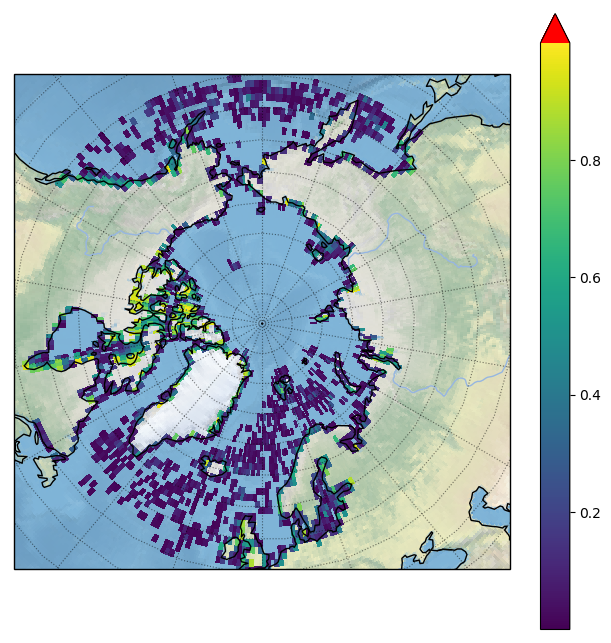

In [522]:
ax = transition_matrices.set_axes()
almost_zero = 1e-5
p= ax.pcolormesh(lonbins, latbins, np.diag(T)[:-1].reshape(nlat,nlon), transform = ccrs.PlateCarree(), vmax = .9)
p.cmap.set_under('k', alpha =0)
p.cmap.set_over('red')
p.set_clim(almost_zero,.9)
plt.colorbar(p, extend = 'max')




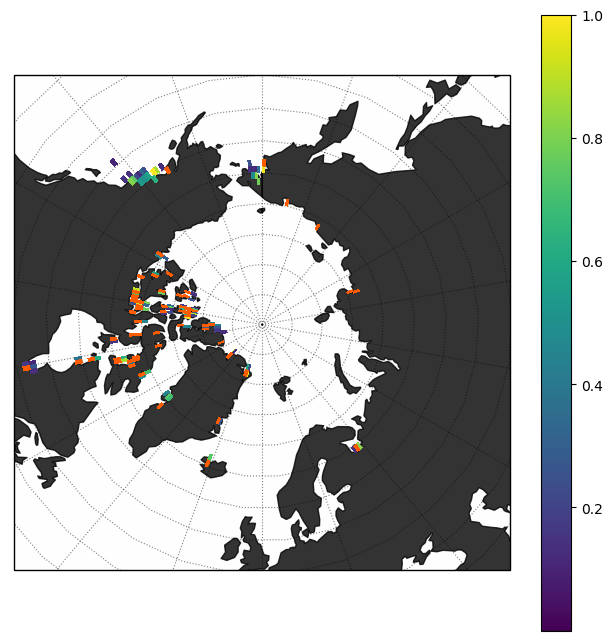

In [549]:
sinks = np.where( np.diag(T)[:-1] > .9)[0]
plt.close("all")

sinks_to_somewhere = T[:-1,sinks[0]]
sinks_from_somewhere = T[sinks[0], :-1]

for s in sinks[1:]:
    sinks_to_somewhere += T[:-1,s]
    sinks_from_somewhere += T[s,:-1]

    
ax = transition_matrices.set_axes()
ax.add_feature(cartopy.feature.OCEAN, facecolor = (1,1,1,.5) ,zorder =1)
ax.add_feature(cartopy.feature.LAND, facecolor = (0,0,0,.8), edgecolor = (0,0,0,0.8) ,zorder =2)

ps= ax.pcolormesh(lonbins, latbins,  sinks_from_somewhere.reshape(nlat,nlon), transform = ccrs.PlateCarree(), zorder = 20, vmin = almost_zero)
ps.cmap.set_under('k', alpha =0)
ps.cmap.set_over('red', alpha = 0)
ps.set_clim(almost_zero, 1)
plt.colorbar(ps)

sink = np.zeros(ncels)
sink[sinks] = 1
p = plt.pcolormesh(lonbins, latbins, sink.reshape(nlat,nlon), vmin = .5, vmax =1.5, cmap = 'hot' , zorder = 30,  transform = ccrs.PlateCarree())
p.cmap.set_under('k', alpha =0)
p.cmap.set_over('red', alpha = 0)
p.set_clim(.5, 1.5)

plt.show()

===============================================================================================================================================================

# voor 15 maart
===============================================================================================================================================================


In [6]:
ds = xr.open_dataset("/home/students/6252699/thesis/parcels2/output/tests2_new_class_ice_or_ocean_kernel_npart_45453_start_2014-02-01_simdays_60_AdvectionRK4_prob" + '.nc', decode_times = False)

In [7]:
ds

<xarray.Dataset>
Dimensions:     (obs: 13, traj: 45453)
Dimensions without coordinates: obs, traj
Data variables:
    trajectory  (traj, obs) int32 ...
    time        (traj, obs) float64 ...
    lat         (traj, obs) float32 ...
    lon         (traj, obs) float32 ...
    z           (traj, obs) float32 ...
    sic         (traj, obs) float32 ...
    in_ice      (traj, obs) float32 ...
    sit         (traj, obs) float32 ...
Attributes:
    feature_type:           trajectory
    Conventions:            CF-1.6/CF-1.7
    ncei_template_version:  NCEI_NetCDF_Trajectory_Template_v2.0
    parcels_version:        2.0.0b0
    parcels_mesh:           spherical

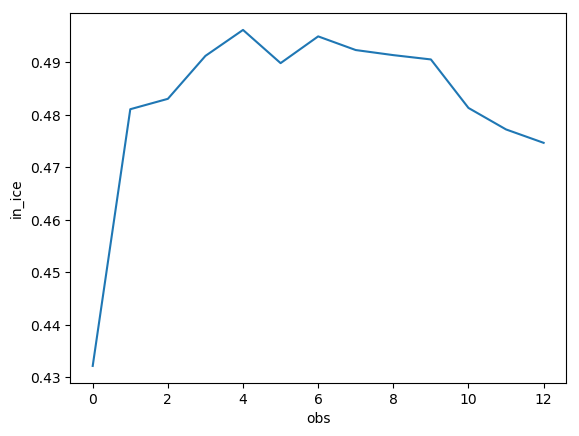

In [8]:
ds.in_ice.mean(dim="traj").plot()

In [9]:
ds.sic.isel(obs=0)

<xarray.DataArray 'sic' (traj: 45453)>
array([0.      , 0.      , 0.      , ..., 0.981552, 0.978748, 0.982159],
      dtype=float32)
Dimensions without coordinates: traj
Attributes:
    long_name:      
    standard_name:  sic
    units:          unknown


# NEW WAY OF CLASSIFYING

In [10]:
def remove_sinks(M):
    '''Remove sinks once'''
    Mdia = np.diag(M)[:-1]
    sinks = np.where(Mdia[:-1]==1)[0]
    Mnosinks = M.copy()
    Mnosinks[sinks, sinks] = 0
    Mnosinks_sum = np.sum(Mnosinks, axis=0)
    Mnosinks_sum[Mnosinks_sum==0] =1
    Mnosinks/=Mnosinks_sum
    return Mnosinks

In [11]:
res = 1
N   = 360//res

lons_init = ds.lon.isel(obs= 0).values
lats_init = ds.lat.isel(obs= 0).values
in_ice_i  = np.floor(ds.in_ice.isel(obs=0).values+0.85)     # fill with the correct values!!!


nparts = len(lons_init)
particle_grid_index = np.zeros((2, nparts), dtype=int)
ncels = int ((360//res) * (40//res))

print ncels
for i in range(nparts):
    if np.isnan(lons_init[i]):
        particle_grid_index[0,i] = -1
    else:
        particle_grid_index[0,i] = int((lats_init[i]-50)//res)*N  + int((lons_init[i]+ 180)//res) + int(in_ice_i[i]) * ncels
        


lons_f   = ds.lon.isel(obs= -1).values
lats_f   = ds.lat.isel(obs= -1).values
in_ice_f = ds.in_ice.isel(obs=-1).values


for i in range(nparts):
    if np.isnan(lons_f[i]):
        particle_grid_index[1,i] = -1
    else:
        particle_grid_index[1,i] = int((lats_f[i]-50)//res)*N  + int((lons_f[i]+ 180)//res) + int(in_ice_f[i]) * ncels
        


T = np.zeros((ncels*2+1,ncels*2+1))


for i in range(nparts):
    T[particle_grid_index[1,i], particle_grid_index[0,i]] += 1

sumT =  np.sum(T, axis=0)
sumT[sumT ==0] = 1
T /=sumT


# remove sinks

max_sink = (np.diag(T)[:-1]).max()
count    = 0
while (max_sink == 1 and count <10):
    T        = remove_sinks(T)
    count   += 1
    max_sink = (np.diag(T)[:-1]).max()

print ("Count is {}" .format(count))
T[:,-1]  = 0
T[-1,-1] = 1

latbins, lonbins= np.arange(50,90+res, res),  np.arange(-180,180+res, res)

14400
Count is 1


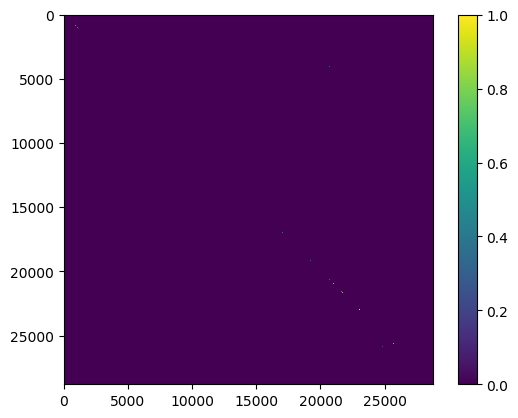

In [12]:
# make sure no particles disappear into the void

zeros = np.where(T.sum(axis=0)==0)
Tkopy = T[:,:]
Tkopy[zeros,:] = 0 
sumTkopy =  np.sum(Tkopy, axis=0)
sumTkopy[sumTkopy ==0] = 1.
Tkopy = Tkopy/sumTkopy

im = plt.imshow(Tkopy )
plt.colorbar(im)



In [13]:
times = 5
nlat     = len(latbins)-1
nlon     = len(lonbins)-1

R        = np.zeros((times, ncels*2+1))
R[0,:]   = 1.
M_sparse = csr_matrix(Tkopy)

for t in range(1,times):
     R[t,:] = M_sparse.dot(R[t-1,:])

In [14]:
sumr = R.sum(axis=1)
sumr[1:]/sumr[:-1]

array([0.26488664, 0.94834168, 0.96020884, 0.96960208])

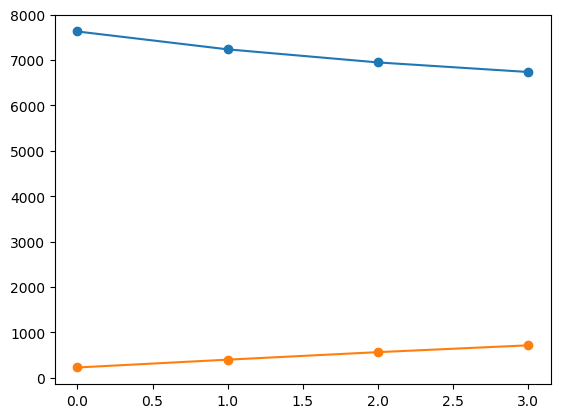

In [15]:
plt.plot(R.sum(axis=1)[1:], marker = 'o')
plt.plot(R[1:,-1], marker = 'o')

(0.03016751919615881, 2.0006673213595123)


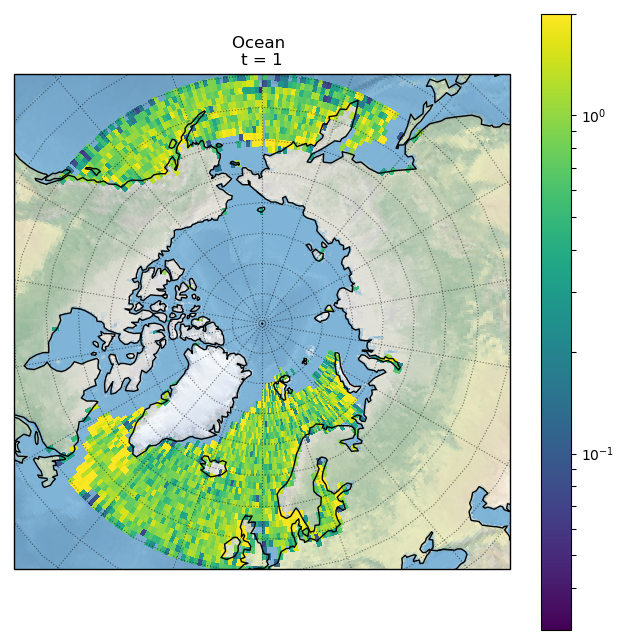

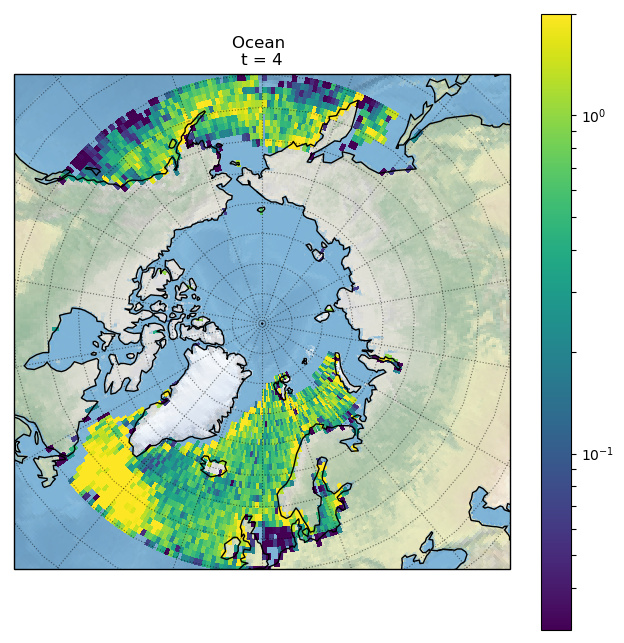

In [16]:

line = sorted(R[R!=0])
vmax = line[int(len(line)*0.95)]  # 95 percentil
vmin = line[int(len(line)*0.01)]  # 1 percentile 
print (vmin, vmax)
nlat, nlon = len(latbins)-1, len(lonbins)-1

times = np.size(R, 0)

for t in [1,times-1]:
    ax   = set_axes()
    p    = ax.pcolormesh(lonbins, latbins, R[t,0:ncels].reshape(nlat,nlon), transform = ccrs.PlateCarree(),  
                         norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), cmap = 'viridis')
    plt.colorbar(p)
    ax.set_title("Ocean \nt = {}".format(t) )
#     plt.show()
    plt.savefig(fig_dir + "/transitionplots/separate_ocean_res_{}_t_{}.png".format(res, t))
#     else: plt.show

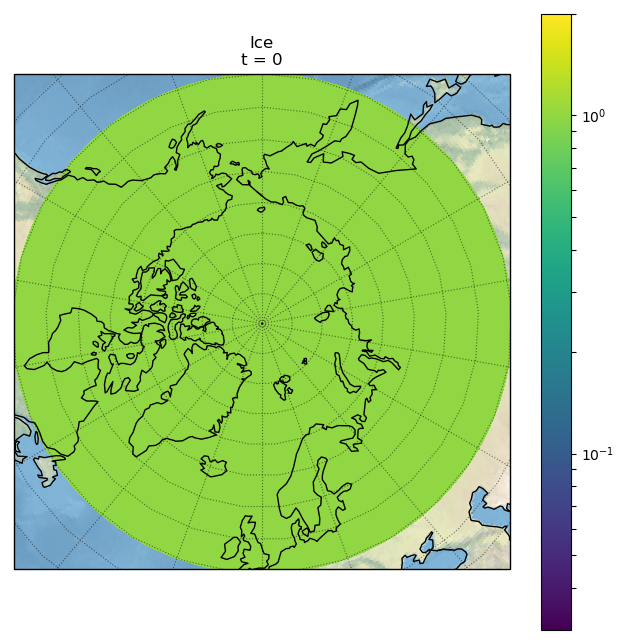

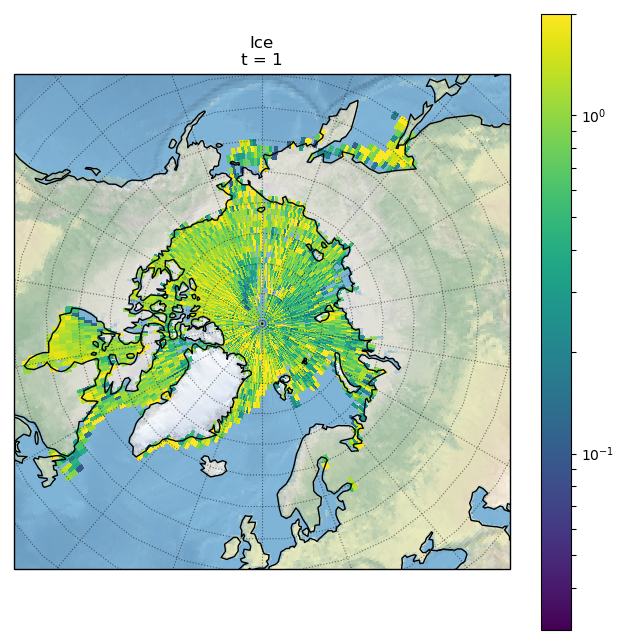

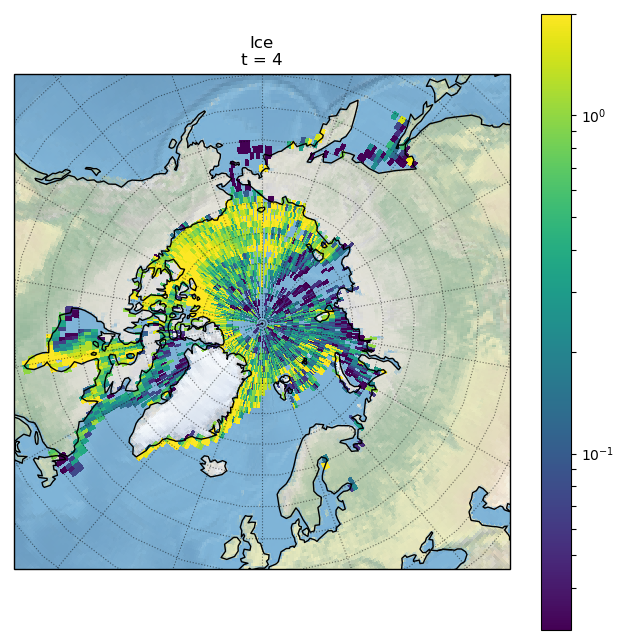

In [71]:

for t in [0,1,times-1]:
    ax   = set_axes()
    p    = ax.pcolormesh(lonbins, latbins, R[t,ncels:-1].reshape(nlat,nlon), transform = ccrs.PlateCarree(),  
                         norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), cmap = 'viridis')
    plt.colorbar(p)
    ax.set_title("Ice\nt = {}".format(t) )
    plt.savefig(fig_dir + "/transitionplots/separate_ice_res_{}_t_{}.png".format(res,t))

    plt.show()

# Eigenvectors

In [18]:
# %%timeit

# eig_val, eig_vec = np.linalg.eig(Tkopy)

In [128]:
eig_val, eig_vec = sla.eigs(M_sparse.transpose(), k = 10, which = 'LM')

In [ ]:
nlat, nlon 

0


TypeError: Dimensions of C (20, 180) are incompatible with X (361) and/or Y (41); see help(pcolormesh)

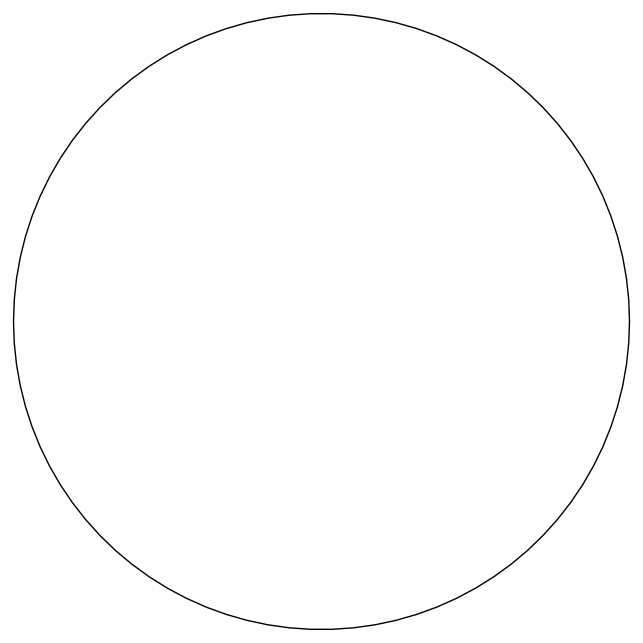

In [129]:
max_color = np.round(np.max(abs(eig_vec)), decimals=2)
max_color = 0.05
labels    = np.round(np.linspace(-max_color, max_color, 5), decimals=2)

for i in range(len(eig_val)):   
    print i
    ax   = set_axes()
    p    = ax.pcolormesh(lonbins, latbins, eig_vec.real[:ncels, i].reshape(nlat,nlon),  
#                          norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), cmap = 'viridis',
                         vmin=-max_color, vmax = max_color,
                         cmap = 'PiYG',
                         transform = ccrs.PlateCarree())
    cbar = plt.colorbar(p, extend = 'both')
    cbar.set_ticks(labels)
    cbar.set_ticklabels(labels)
    ax.set_title(r"Ocean: $\lambda = $ {}".format(eig_val[i]) )
    plt.savefig(fig_dir + "/transitionplots/eigen/{}_left_separate_ocean_res_{}.png".format(i,res))
    
    
    ax   = set_axes()
    p    = ax.pcolormesh(lonbins, latbins, eig_vec.real[ncels:-1,i].reshape(nlat,nlon), 
#                          norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), cmap = 'viridis',
                         vmin=-max_color, vmax = max_color,  
                         cmap = 'PiYG',
                         transform = ccrs.PlateCarree() )
    plt.colorbar(p, extend = 'both')
    ax.set_title(r"Ice: $\lambda = $ {}".format(eig_val[i]) )
    cbar.set_ticks(labels)
    cbar.set_ticklabels(labels)
    plt.savefig(fig_dir + "/transitionplots/eigen/{}_left_separate_ice_res_{}.png".format(i, res))
    plt.show()



In [152]:
def eigen_vector(M,  latbins, lonbins, k=10,  savefig = False, save_name="", in_ice = False):
    
    nlat, nlon = len(latbins)-1, len(lonbins)-1
    ncels      = nlat*nlon
    eig_val_l, eig_vec_l = sla.eigs(M.transpose(), k = k, which = 'LM')
    eig_val_r, eig_vec_r = sla.eigs(M, k = k, which = 'LM')

    max_color = np.round(np.mean([abs(eig_vec_l), abs(eig_vec_r)])*2, decimals=6)
    print(max_color)
    print(np.mean(([abs(eig_vec_l), abs(eig_vec_r)])))
    max_color = 5e-4
    labels    = np.round(np.linspace(-max_color, max_color, 5), decimals=7)

    for i in range(k):
        fig = plt.figure(figsize = [10,6])
        fig.suptitle(r"$\lambda = $ {} , {}".format(eig_val_l[i], eig_val_l[i]), fontsize=16)
        ax1 = fig.add_subplot(1, 2, 1, projection=ccrs.NorthPolarStereo())
        ax1 = set_subaxes(ax1)        
        p    = ax1.pcolormesh(lonbins, latbins, eig_vec_l.real[:ncels, i].reshape(nlat,nlon),  
                             vmin=-max_color, vmax = max_color,
                             cmap = 'PiYG',
                             transform = ccrs.PlateCarree())

        ax1.set_title("left")
        
        ax2 = fig.add_subplot(1, 2, 2, projection=ccrs.NorthPolarStereo())
        ax2 = set_subaxes(ax2)        
        ax2.pcolormesh(lonbins, latbins, eig_vec_r.real[:ncels, i].reshape(nlat,nlon),  
                             vmin=-max_color, vmax = max_color,
                             cmap = 'PiYG',
                             transform = ccrs.PlateCarree())

        ax2.set_title("right" )
        fig.subplots_adjust(right=0.9)
        cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
        cbar = fig.colorbar(p, cax=cbar_ax, extend = 'both')
        cbar.set_ticks(labels)
        cbar.set_ticklabels(labels)
#         cbar = plt.colorbar(p, extend = 'both')

        
        
        
        if savefig: plt.savefig(fig_dir + "/transitionplots/eigen/{}_{}_res_{}.png".format(save_name, i,res))


        if in_ice: 
            ax   = set_axes()
            p    = ax.pcolormesh(lonbins, latbins, eig_vec.real[ncels:-1,i].reshape(nlat,nlon), 
        #                          norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), cmap = 'viridis',
                                 vmin=-max_color, vmax = max_color,  
                                 cmap = 'PiYG',
                                 transform = ccrs.PlateCarree() )
            plt.colorbar(p, extend = 'both')
            ax.set_title(r"Ice: $\lambda = $ {}".format(eig_val[i]) )
            cbar.set_ticks(labels)
            cbar.set_ticklabels(labels)
            if save_fig: plt.savefig(fig_dir + "/transitionplots/eigen/{}_left_separate_ice_res_{}.png".format(i, res))
        plt.show()
        


In [153]:
# ds_name = "/home/students/6252699/thesis/parcels2/output/tests2_new_class_ice_or_ocean_kernel_npart_45453_start_2014-02-01_simdays_60_AdvectionRK4_prob" + '.nc'
# T, latbins , lonbins, M_sparse = transition_matrices.trans_mat_digit(ds_name, 1, final_index =-1, in_ice = False, void = True)

0.003163
0.001581379421198889


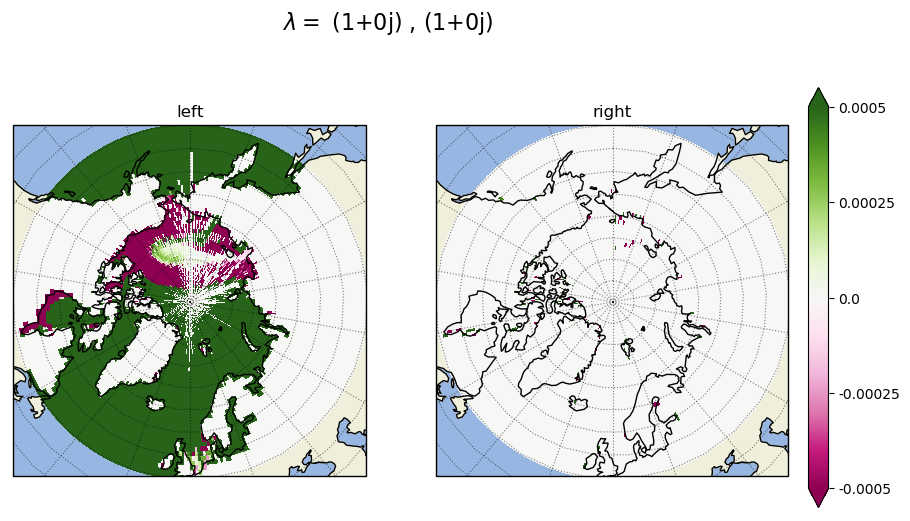

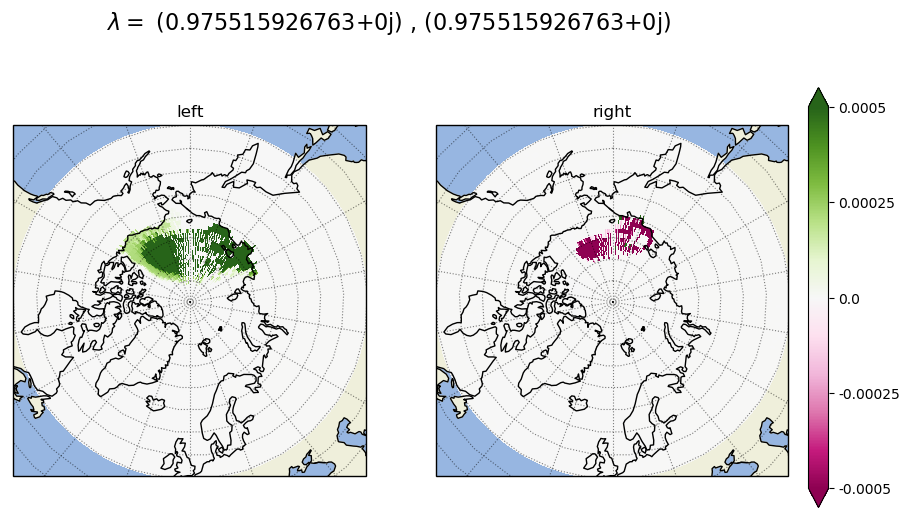

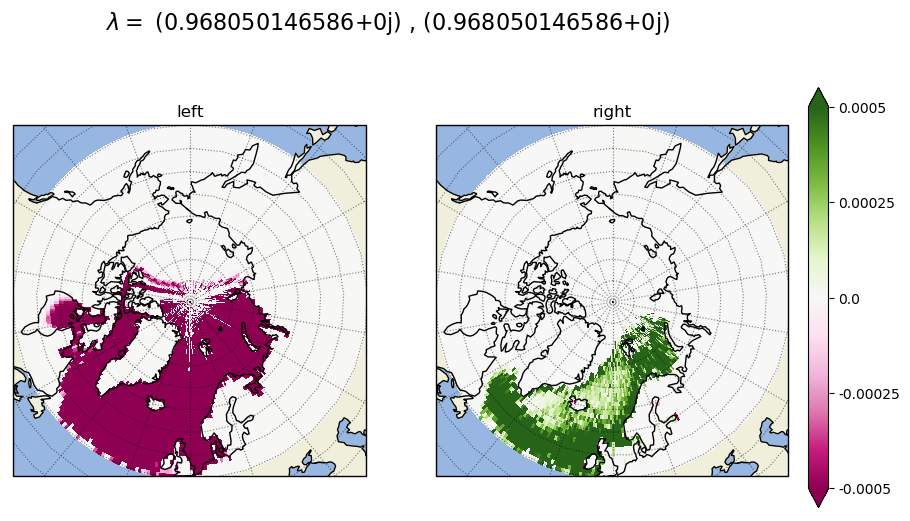

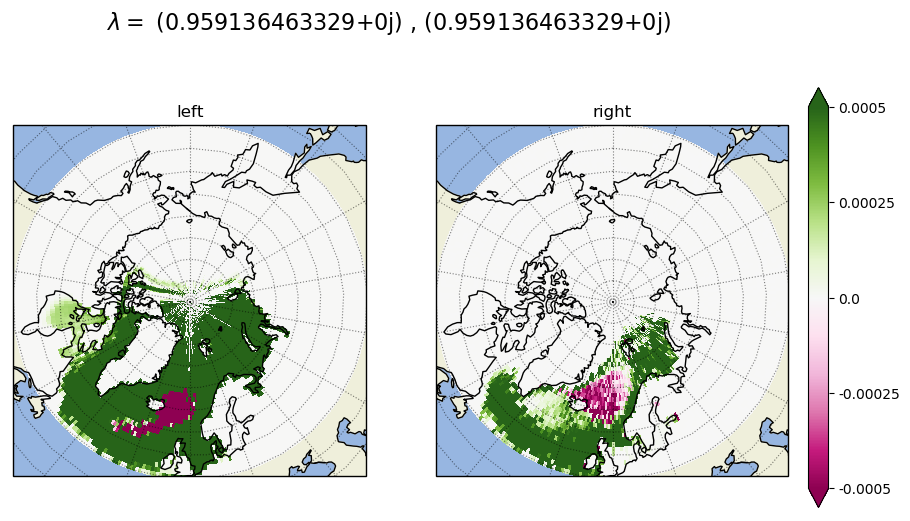

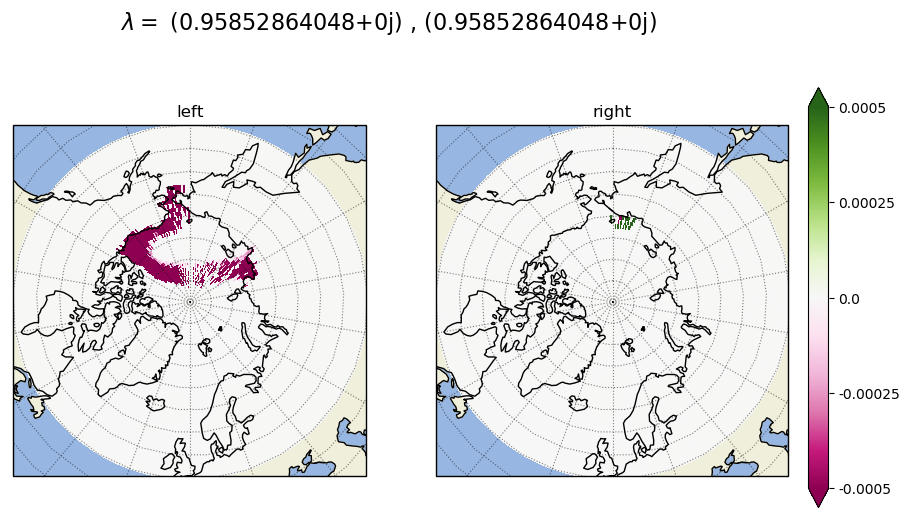

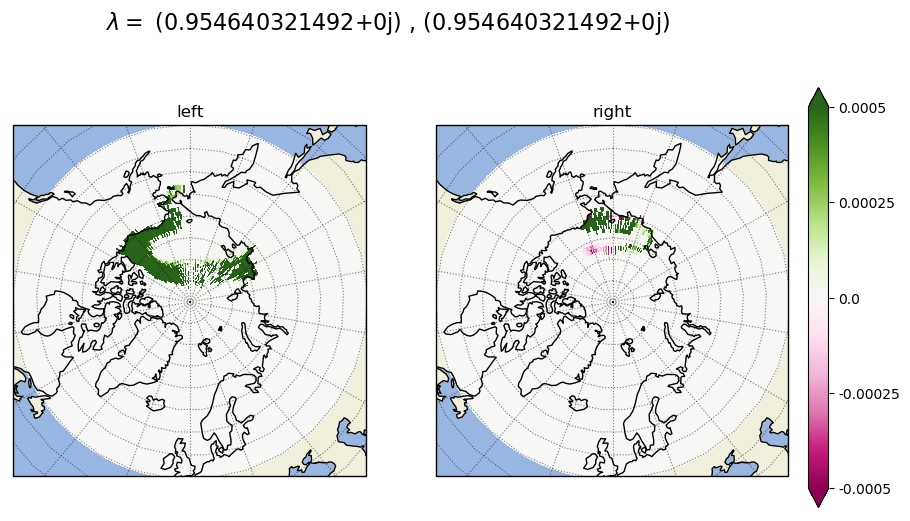

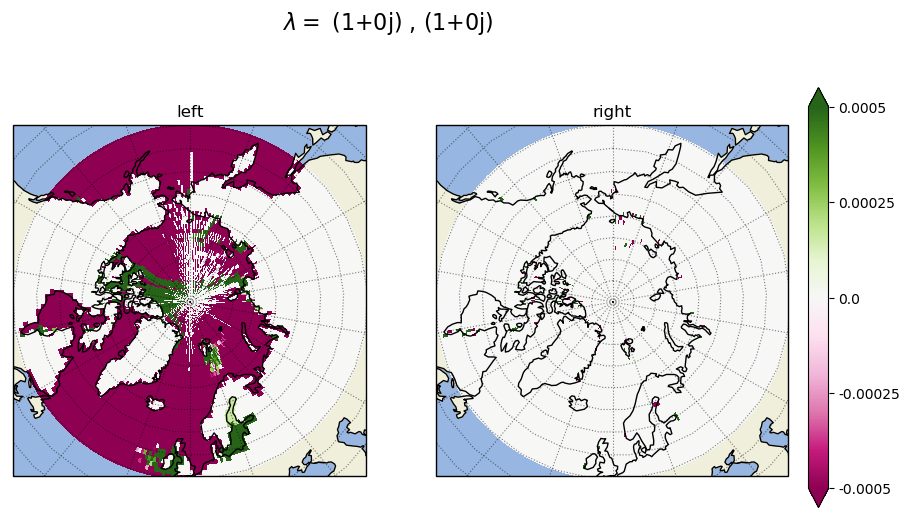

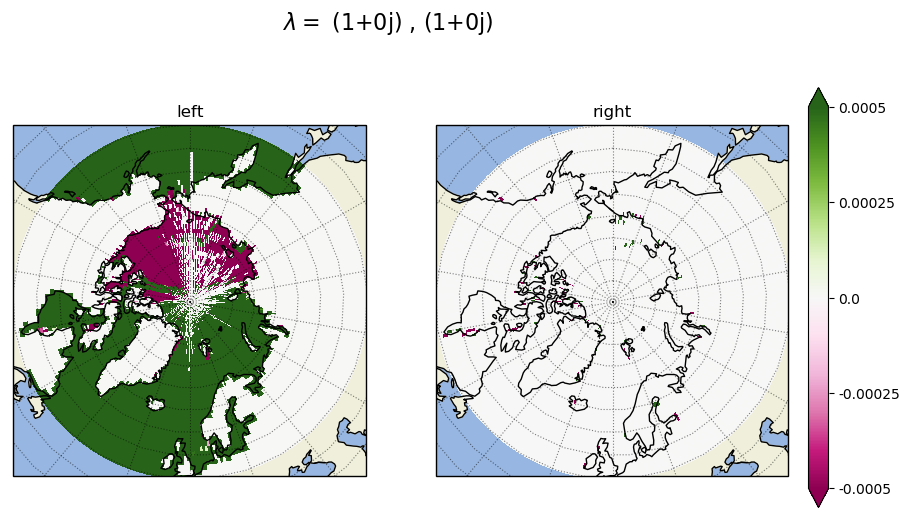

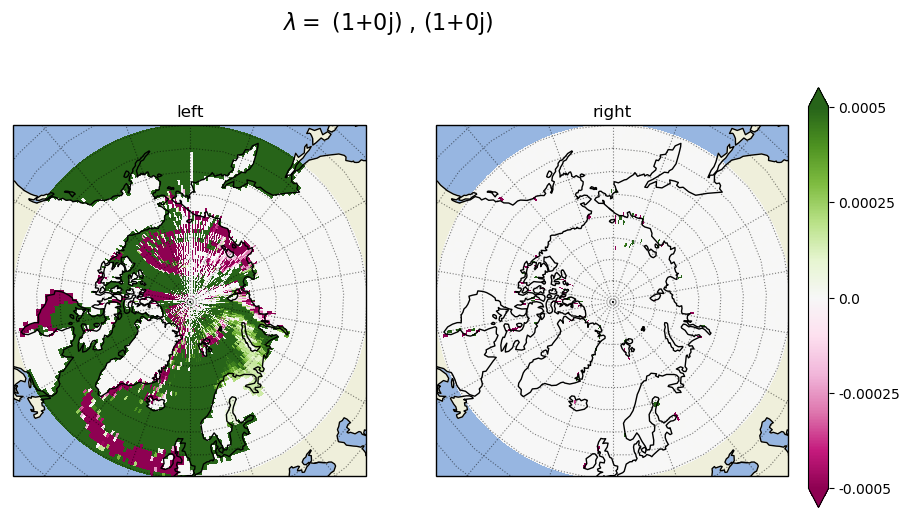

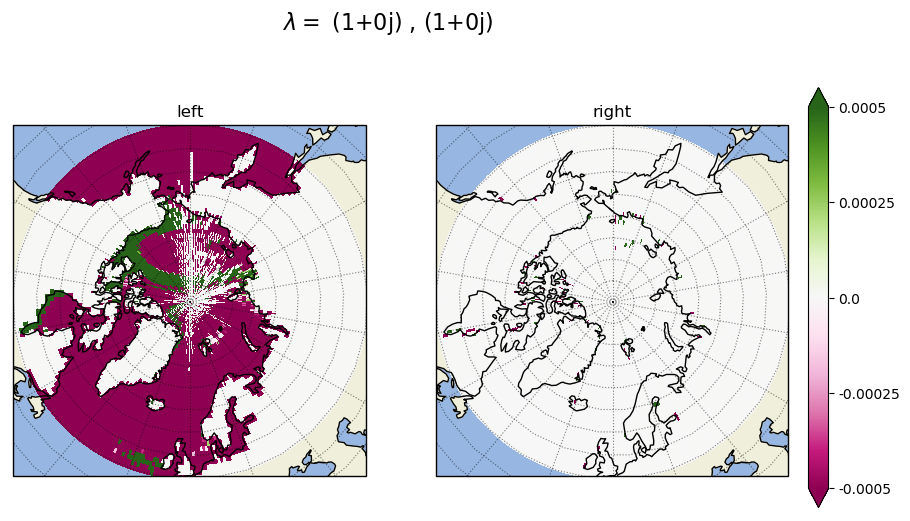

In [154]:
eigen_vector(M_sparse,  latbins, lonbins, k=10,  savefig = False, save_name="", in_ice = False)

# DIGITIZED BUT NOT SEPERATE OCEAN AND ICE

In [ ]:


res = 2
N   = 360//res
print nparts

lons_init = ds.lon.isel(obs= 0).values
lats_init = ds.lat.isel(obs= 0).values

nparts = len(lons_init)
particle_grid_index = np.zeros((2, nparts), dtype=int)
for i in range(nparts):
    if np.isnan(lons_init[i]):
        particle_grid_index[0,i] = -1
    else:
        particle_grid_index[0,i] = int((lats_init[i]-50)//res)*N  + int((lons_init[i]+ 180)//res)
        


lons_f = ds.lon.isel(obs= -1).values
lats_f = ds.lat.isel(obs= -1).values

for i in range(nparts):
    if np.isnan(lons_f[i]):
        particle_grid_index[1,i] = -1
    else:
        particle_grid_index[1,i] = int((lats_f[i]-50)//res)*N  + int((lons_f[i]+ 180)//res)
        

ncels = 360//res * 40//res +1

T = np.zeros((ncels,ncels))


for i in range(nparts):
    T[particle_grid_index[1,i], particle_grid_index[0,i]] += 1

sumT =  np.sum(T, axis=0)
sumT[sumT ==0] = 1
T /=sumT

T[:,-1]  = 0
T[-1,-1] = 1

In [ ]:
M, latbins, lonbins = transition_matrices.trans_mat(res, lons_init, lons_f,lats_init,  lats_f, nosinks = False)

In [ ]:
bins = [np.arange(-180,180+res,res), np.arange(50,90+res, res)]

In [ ]:
hi , _, _, im = plt.hist2d(lons_init,lats_init, bins = bins)
plt.colorbar(im)


In [ ]:
fin = np.where(~np.isnan(lons_f))

hf, _, _, im = plt.hist2d(lons_f[fin],lats_f[fin], bins = bins)
plt.colorbar(im)


In [ ]:
np.shape(hi)

In [ ]:
hi_flat = hi.T.flatten()

In [ ]:
p = plt.pcolormesh(hi_flat.reshape(20,180))
plt.colorbar(p)

In [ ]:
T_hf = np.dot(T[:-1,:-1],hi_flat)

In [ ]:
p = plt.pcolormesh(T_hf.reshape(20,180))
plt.colorbar(p)

In [ ]:
p = plt.pcolormesh((T_hf - hf.T.flatten()).reshape(20,180))
plt.colorbar(p)

In [ ]:
np.where(T_hf == 180)

In [60]:
def strom(k):
    x = np.linspace(-2*np.pi, 2*np.pi, 1000)
    y = (2*np.cos(k*x)*np.cos(k/10*x))
    plt.plot(x,y, label = "{}".format(k))

In [73]:
ocean_file = "/home/students/6252699/thesis/parcels2/output/03-08-tests2_new_class_ice_or_ocean_kernel_npart_45453_start_2014-02-01_simdays_61_AdvectionRK4_ocean.nc"
ds_ocean   = xr.open_dataset(ocean_file, decode_times=False)

In [87]:
res = 2
N   = 360//res

lons_init = ds_ocean.lon.isel(obs= 0).values
lats_init = ds_ocean.lat.isel(obs= 0).values
# in_ice_i  = np.floor(ds_ocean.in_ice.isel(obs=0).values+0.85)     # fill with the correct values!!!


nparts = len(lons_init)
particle_grid_index = np.zeros((2, nparts), dtype=int)
ncels = int ((360//res) * (40//res))

print ncels
for i in range(nparts):
    if np.isnan(lons_init[i]):
        particle_grid_index[0,i] = -1
    else:
        particle_grid_index[0,i] = int((lats_init[i]-50)//res)*N  + int((lons_init[i]+ 180)//res) 
        


lons_f   = ds_ocean.lon.isel(obs= -1).values
lats_f   = ds_ocean.lat.isel(obs= -1).values
in_ice_f = ds_ocean.in_ice.isel(obs=-1).values


for i in range(nparts):
    if np.isnan(lons_f[i]):
        particle_grid_index[1,i] = -1
    else:
        particle_grid_index[1,i] = int((lats_f[i]-50)//res)*N  + int((lons_f[i]+ 180)//res) #+ int(in_ice_f[i]) * ncels
        


T = np.zeros((ncels+1,ncels+1))


for i in range(nparts):
    T[particle_grid_index[1,i], particle_grid_index[0,i]] += 1

sumT =  np.sum(T, axis=0)

latbins, lonbins= np.arange(50,90+res, res),  np.arange(-180,180+res, res)



3600


In [139]:
class run_properties():
    
    def __init__(self, file_name):
        
        self.file_name    = file_name
        seperated         = self.file_name.split('_')
        self.run_date     = seperated[0].split('bigrun/')[1]
        self.npart        = seperated[2]
        self.start_date   = seperated[4]
        self.simdays      = seperated[6]
        self.kernel       = (seperated[-2] + seperated[-1]).split('.')[0]
    
    
        print('The run date is  {}'.format(self.run_date))
        print('N. particles   : {}'.format(self.npart))
        print('Starting date  : {}'.format(self.start_date))
        print('Simulated days : {}'.format(self.simdays))
        print('Kernel used    : {}'.format(self.kernel))

In [262]:
runtest = run_properties(names_13_march[0])

The run date is 03-13
N. particles :  487787
Starting date : 2014-02-11
Simulated days: 40
Kernel used:    AdvectionRK4ocean


========================================================================================================
# Plot just extent contour
========================================================================================================

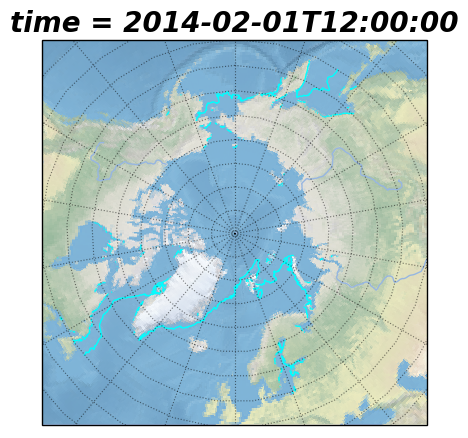

In [15]:
 
def plot_extent(date, ax): 
    ds     = xr.open_dataset('/scratch/AnnekeV/reanalysis_data/GLOBAL_REANALYSIS_PHY_001_030-TDS_{}{:02d}{:02d}_uv_uvice_con_thick.nc'.format(date.year, date.month, date.day))
    siconc = ds.siconc
    sic    = siconc.isel(time=0).plot.contour(ax = ax, transform = ccrs.PlateCarree(), cmap ="cool", levels = [0.15,1.1], add_colorbar=False, linewidths=1)
    
def open_sic(date):
    date   = datetime.datetime.strptime(date, "%Y-%m-%d").date()
    ds     = xr.open_dataset('/scratch/AnnekeV/reanalysis_data/GLOBAL_REANALYSIS_PHY_001_030-TDS_{}{:02d}{:02d}_uv_uvice_con_thick.nc'.format(date.year, date.month, date.day))
    siconc = ds.siconc.isel(time=0)
    return siconc
    
for stringdate in ['2014-02-01']:
    date = datetime.datetime.strptime(stringdate, "%Y-%m-%d").date()
    fig  = plt.figure(figsize=[5,5])
    ax   = transition_matrices.set_axes(fig)
    plot_extent(date,ax)

In [401]:
def mod(eig):
    return Reeig/abs(eig) 

mod(np.sin(np.linspace(-10+ 2j,10-2j,100)))

array([ 0.55807784-0.8297886j ,  0.37730409-0.92608942j,
        0.17761115-0.98410075j, -0.03230591-0.99947803j,
       -0.2420562 -0.97026223j, -0.44055605-0.89772511j,
       -0.61751714-0.78655743j, -0.76488349-0.64416865j,
       -0.87763756-0.47932485j, -0.9537252 -0.30067965j,
       -0.99328223-0.11571692j, -0.99757016+0.06966902j,
       -0.96798469+0.25100926j, -0.90534449+0.42467795j,
       -0.80956337+0.58703249j, -0.67982681+0.73337269j,
       -0.51550505+0.85688654j, -0.31807819+0.94806448j,
       -0.09393248+0.99557857j,  0.14338445+0.98966706j,
        0.3741864 +0.92735351j,  0.57830734+0.81581899j,
        0.742107  +0.67028143j,  0.86149724+0.50776225j,
        0.93981278+0.34168984j,  0.98366338+0.18001763j,
        0.99966325+0.02594974j,  0.99270684-0.1205534j ,
        0.9652014 -0.26150765j,  0.91649113-0.40005501j,
        0.84185001-0.53971156j,  0.73058402-0.68282281j,
        0.56365369-0.82601121j,  0.31602926-0.94874944j,
       -0.01850336-0.9998288j ,

In [391]:
   
def right_eigen_vector(M,  latbins, lonbins, title, date,  k=10,  savefig = False, save_name="", in_ice = False):
    '''
    Calculates from sparse transition matrix M the 15 biggest right eigenvectors
    
    M = sparse matrix
    latbins, lonbins. The edges of the longitudes and latitudes
    title = title of the matrix
    k = number of eigenvalues calculated
    date is a string '2014-02-01' to calculate the extent
    '''
    
    
    nlat, nlon   = len(latbins)-1, len(lonbins)-1
    ncels        = nlat*nlon
    eig_val_r, eig_vec_r = sla.eigs(M, k = k, which = 'LM')
    idx          = eig_val_r.argsort()[::-1]   
    eig_val_r    = eig_val_r[idx]
    eig_vec_r    = eig_vec_r[:,idx]
    
    print("Calculated right eigenvectors, currently plotting")

    max_color    = 0.0001
    labels       = np.round(np.linspace(-max_color, max_color, 5), decimals=6)

    
    count = 0
    fig   = plt.figure(figsize = [15, 9])
    fig.suptitle(title, fontsize=20)
    sic   = open_sic(date=date)

    for i in range(k):
        count += 1
        ax = fig.add_subplot(3, 5, count, projection=ccrs.NorthPolarStereo())
        ax = transition_matrices.set_subaxes(ax) 
        ax.coastlines(linewidth=.5, alpha = 0.8)

        p    = ax.pcolormesh(lonbins, latbins, abs(eig_vec_r[:ncels, i].reshape(nlat,nlon)),  
                         vmin=-max_color, vmax = max_color,
                         cmap = 'PiYG',
                         transform = ccrs.PlateCarree())
        sic.plot.contour(ax = ax, transform = ccrs.PlateCarree(), cmap ="cool", levels = [0.15,1.1], add_colorbar=False, linewidths=1)
        ax.set_title(r"$\lambda = $ {:.3f}".format( eig_val_r[i]), fontsize =10)
        transition_matrices.box("{:.2f}".format(abs(eig_vec_r[-1,i]) ), .05 , .95 , ax)
        set_circular_boundary(ax)
        add_grid_labels(ax,-160,180,50,90,40,10, latlabels=False)

    fig.subplots_adjust(bottom = 0.10)
    cbar_ax = fig.add_axes([0.15, 0.06, 0.7, .03])
    cbar = fig.colorbar(p, cax=cbar_ax, orientation = 'horizontal', extend = 'both')
    cbar.set_ticks(labels)
    cbar.set_ticklabels(labels)
    


In [229]:
names_1415 = sorted(names_13_march_2014_ice+names_13_march_2015_ice)

In [263]:
names_13_march_2016_ice


['/scratch/AnnekeV/output/bigrun/03-13_npart_487787_start_2016-02-11_simdays_40_kernel_AdvectionRK4_prob.nc',
 '/scratch/AnnekeV/output/bigrun/03-13_npart_487790_start_2016-02-21_simdays_20_kernel_AdvectionRK4_prob.nc',
 '/scratch/AnnekeV/output/bigrun/03-13_npart_487791_start_2016-02-01_simdays_60_kernel_AdvectionRK4_prob.nc']

In [231]:
np.shape(T)

(3601, 3601)

The run date is  03-13
N. particles   : 487787
Starting date  : 2016-02-11
Simulated days : 40
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


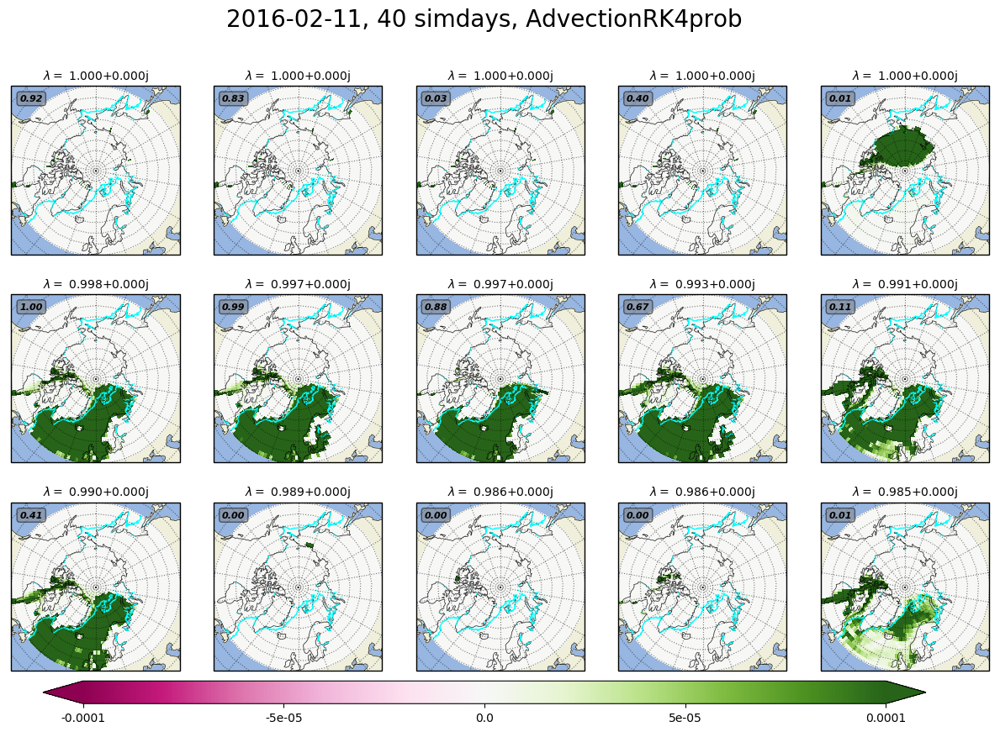

The run date is  03-13
N. particles   : 487790
Starting date  : 2016-02-21
Simulated days : 20
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


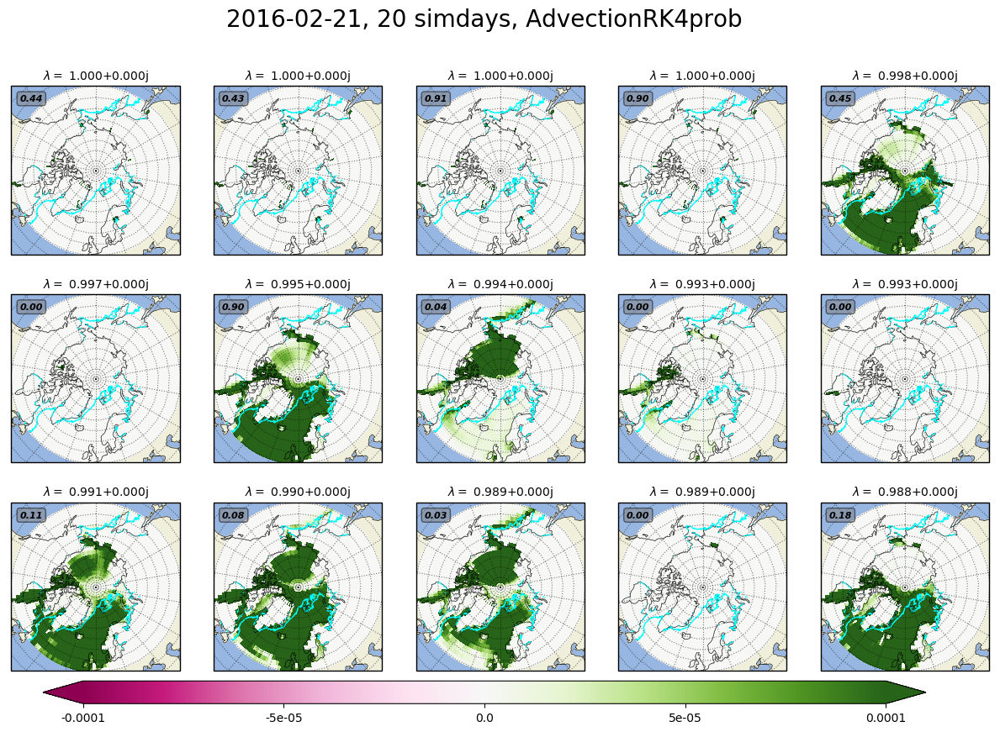

The run date is  03-13
N. particles   : 487791
Starting date  : 2016-02-01
Simulated days : 60
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


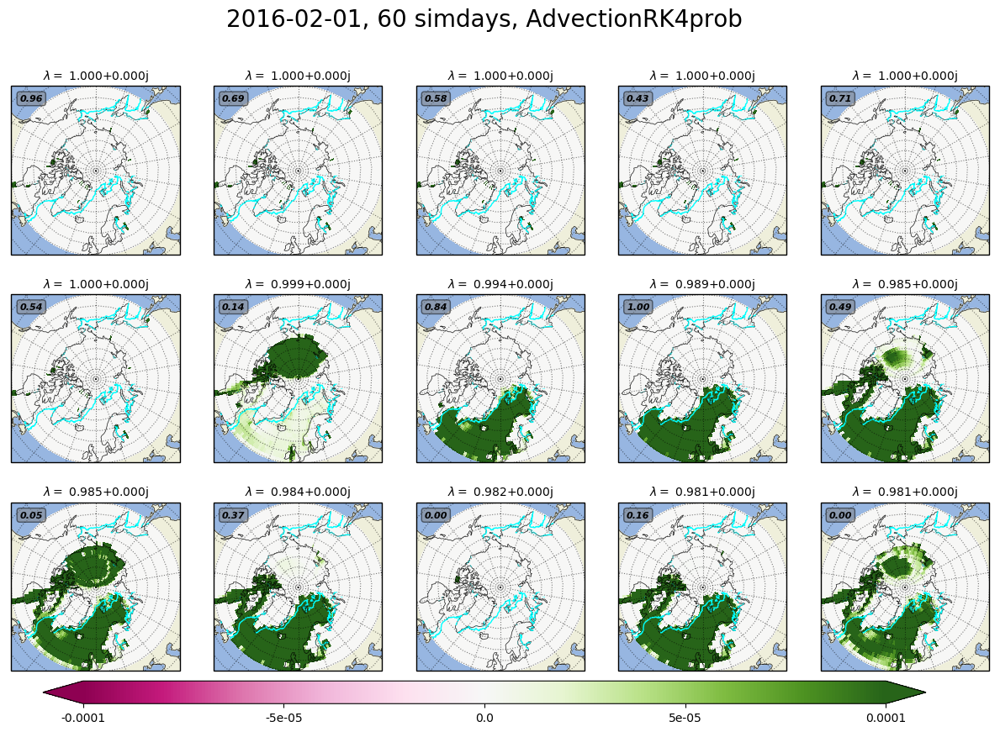

The run date is  03-13
N. particles   : 487787
Starting date  : 2016-02-11
Simulated days : 40
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


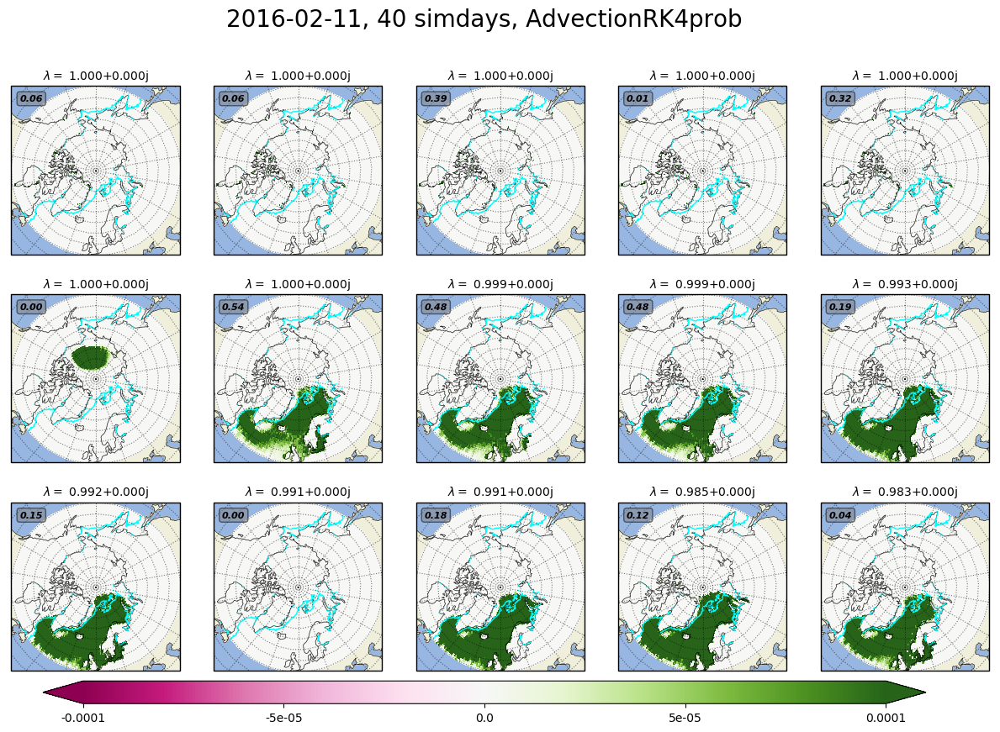

The run date is  03-13
N. particles   : 487790
Starting date  : 2016-02-21
Simulated days : 20
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


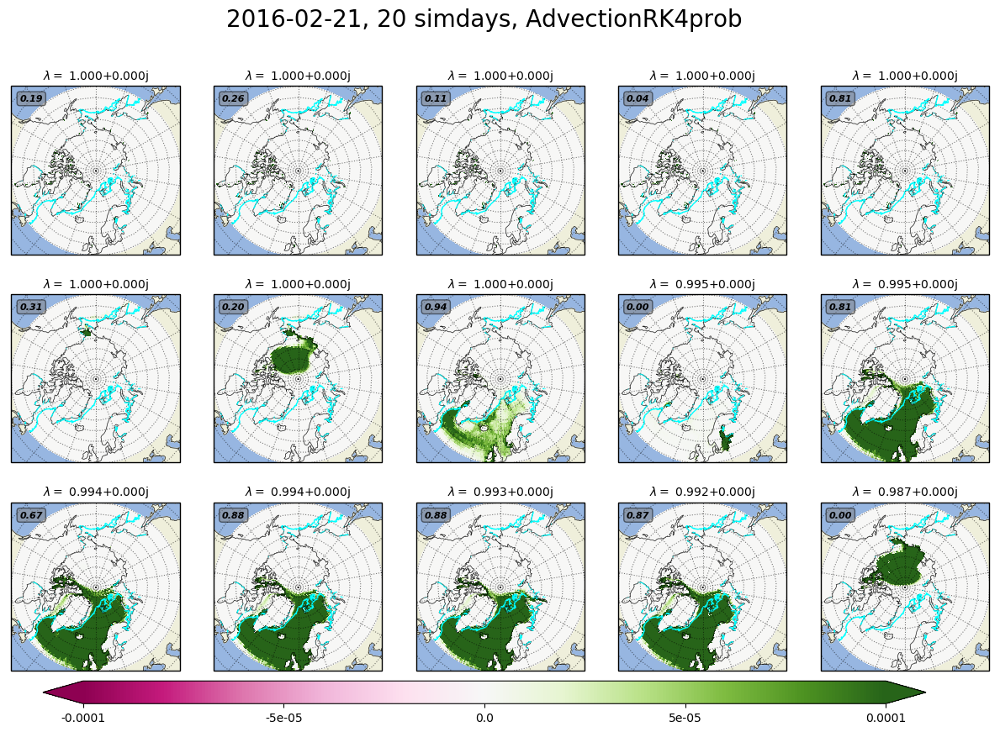

The run date is  03-13
N. particles   : 487791
Starting date  : 2016-02-01
Simulated days : 60
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


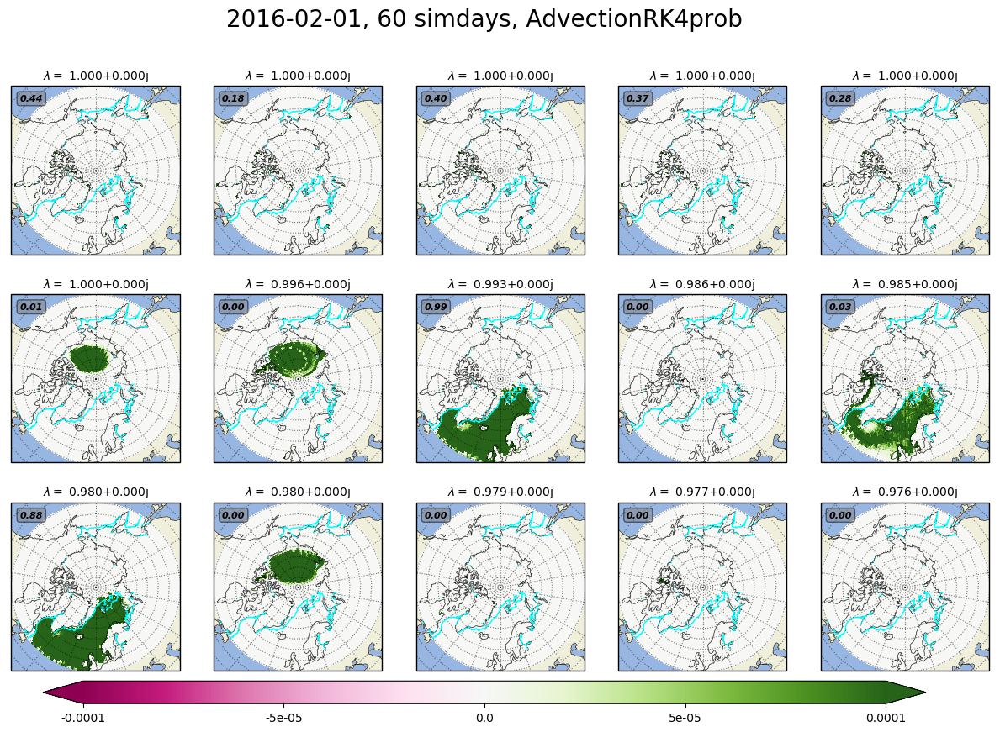

The run date is  03-13
N. particles   : 487787
Starting date  : 2016-02-11
Simulated days : 40
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


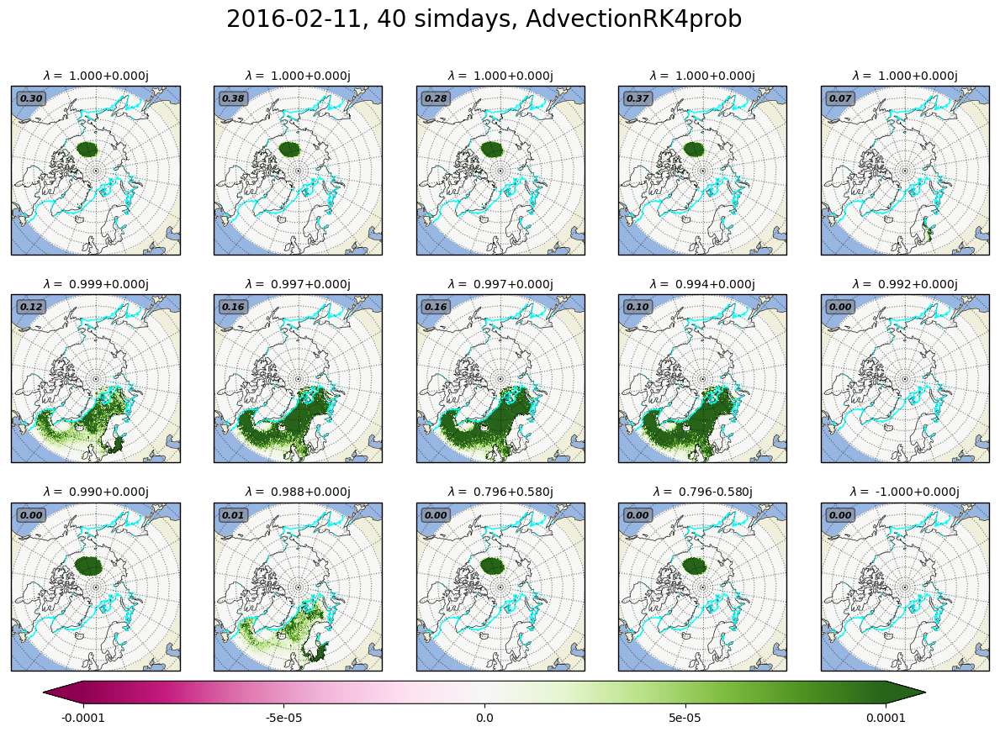

The run date is  03-13
N. particles   : 487790
Starting date  : 2016-02-21
Simulated days : 20
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


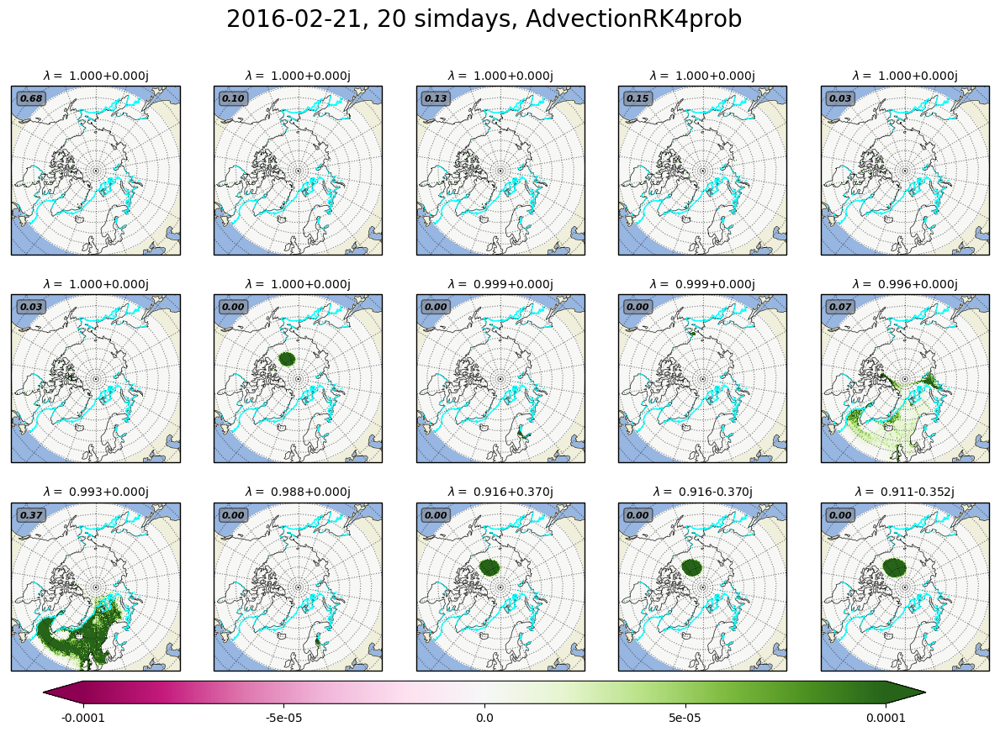

The run date is  03-13
N. particles   : 487791
Starting date  : 2016-02-01
Simulated days : 60
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
Calculated right eigenvectors, currently plotting


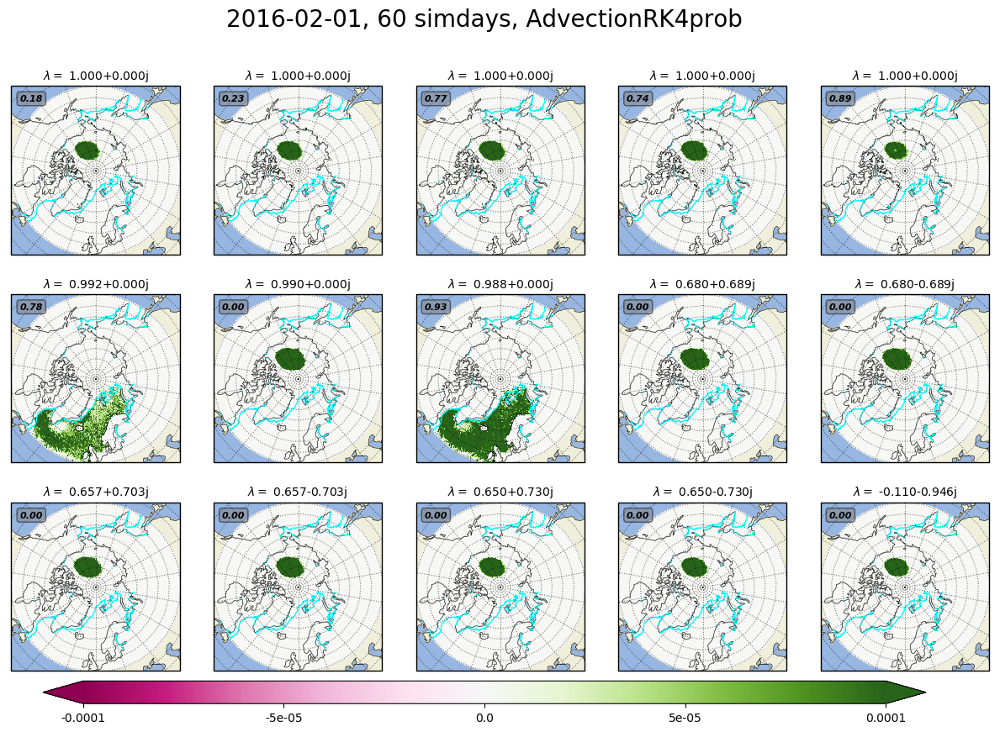

In [268]:
plt.close()

FILES = names_13_march_2016_ice

for res in [2., 1., .5]:
    for i in range(len(FILES)):
# for res in [2.]:
#     for i in [0]:
        run_prop = run_properties(FILES[i])
        title = "{}, {} simdays, {}".format(run_prop.start_date,run_prop.simdays, run_prop.kernel)
        T, latbins, lonbins, M = transition_matrices.trans_mat_digit(FILES[i], res=res, final_index =-1, in_ice = False, void = True)
        right_eigen_vector(M,latbins, lonbins, title = title, k=15, date = run_prop.start_date)
        plt.savefig(fig_dir + "transitionplots/04_01/eigenvec_res_{:02d}_{}.png".format( int(res*10),run_prop.start_date), bbox_inches="tight", pad_inches=0.1)
        plt.show()

In [417]:
plt.close()

FILES = names_13_march_2016_ice

for res in [1]:
    for i in [0]:
# for res in [2.]:
#     for i in [0]:
        mpl.rcParams['font.size'] = 8

        run_prop = run_properties(FILES[i])
        title = "{}, {} simdays, {}".format(run_prop.start_date,run_prop.simdays, run_prop.kernel)
        T, latbins, lonbins, M = transition_matrices.trans_mat_digit(FILES[i], res=res, final_index =-1, in_ice = False, void = True)
#         right_eigen_vector(M,latbins, lonbins, title = title, k=15, date = run_prop.start_date)
#         plt.savefig(fig_dir + "transitionplots/04_01/eigenvec_res_{:02d}_{}.png".format( int(res*10),run_prop.start_date), bbox_inches="tight", pad_inches=0.1)
        plt.show()

The run date is  03-13
N. particles   : 487787
Starting date  : 2016-02-11
Simulated days : 40
Kernel used    : AdvectionRK4prob
Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T


In [208]:
ctest = 3+4j

In [209]:
ctest

(3+4j)

In [210]:
abs(ctest)

5.0

In [ ]:
ax
plt.show()

In [356]:
def add_grid_labels(ax, x0, x1, y0, y1, dx, dy,
                     latlabels=True):
    """Add grid line labels manually for projections that aren't supported

    Args:
        ax (geoaxes.GeoAxesSubplot) 
        x0 (scalar)
        x1 (scalar)
        y0 (scalar)
        y1 (scalar)
        dx (scalar)
        dy (scalar)
        latlabels (Boolean)
    """
    dtype = int
    
    if latlabels:
        for lat in np.arange(y0, y1, dy, dtype=dtype):
            text = ax.text(180, lat, r" {}$^o$N".format(lat), ha='left', va = 'bottom', transform = ccrs.PlateCarree())

        
    for lon in np.arange(x0, x1, dx, dtype=dtype):
            if abs(lon) < 90:
                va = 'top'
            elif abs(lon) > 90:
                va = 'bottom'
            elif abs(lon) == 90:
                va = 'center'
                
            if (lon) < 0:
                ha = 'right'
            elif (lon) > 0:
                ha = 'left'
            elif (lon == 0 or abs(lon) == 180):
                ha = 'center'
            
            text = ax.text(lon,y0, r"{}$^o$E".format(lon), ha = ha, va = va, transform = ccrs.PlateCarree())
                

def set_circular_boundary(ax):
    '''
    Compute a circle in axes coordinates, which we can use as a boundary
    for the map. We can pan/zoom as much as we like - the boundary will be
    permanently circular.
    '''
    import matplotlib.path as mpath
  
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax.set_boundary(circle, transform=ax.transAxes)               
                

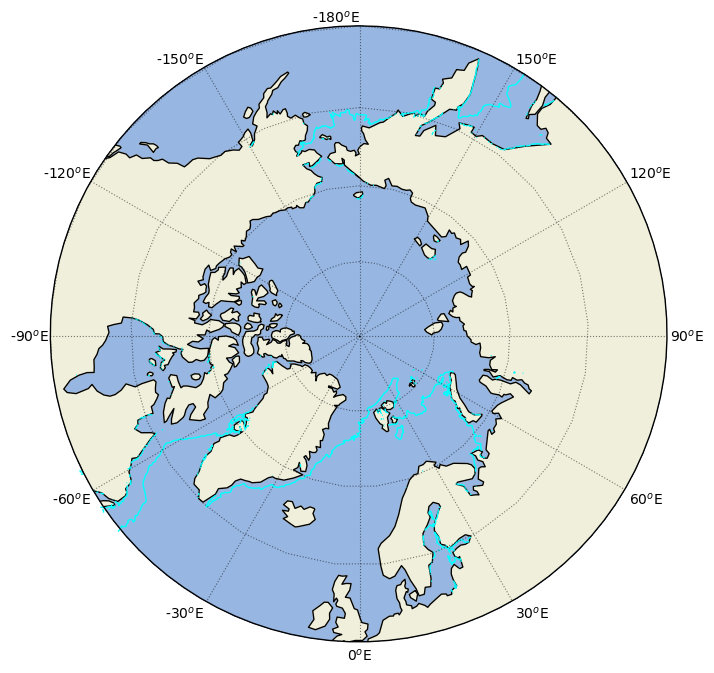

In [384]:
sic = open_sic('2014-02-01')
plt.figure(figsize = [8,8])
ax = plt.axes(projection=ccrs.NorthPolarStereo())
ax.gridlines(xlocs = np.arange(-180,185,30), ylocs = np.arange(0,95,10), color='black', alpha=0.5, linestyle=':')
ax.add_feature(cartopy.feature.OCEAN)
ax.add_feature(cartopy.feature.LAND)
ax.set_extent([-180,180,ymin,ymax],  ccrs.PlateCarree())
ax.coastlines()
sic.plot.contour(ax = ax, transform = ccrs.PlateCarree(), cmap ="cool", levels = [0.15,2], add_colorbar=False, linewidths=1 )
ax.set_title("")


add_grid_labels(ax,-180,180,50,90,30,10, latlabels=False)
set_circular_boundary(ax)


In [405]:
np.diag(T)[:-1]

array([0.06222222, 0.17857143, 0.08444444, ..., 0.        , 0.        ,
       0.        ])

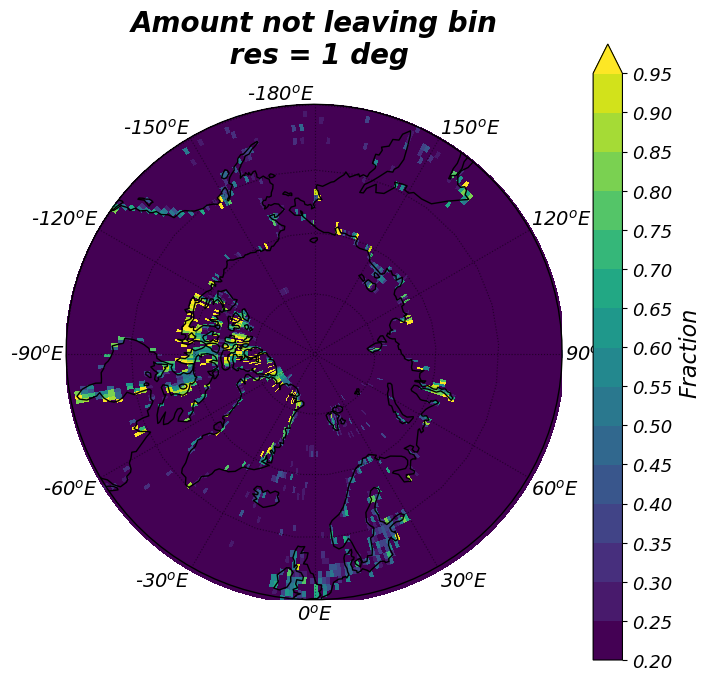

In [450]:
sic = open_sic('2014-02-01')

def plot_amount_within_bin(T, latbins,lonbins):
    plt.figure(figsize = [8,8])
    ax = plt.axes(projection=ccrs.NorthPolarStereo())
    ax.gridlines(xlocs = np.arange(-180,185,30), ylocs = np.arange(0,95,10), color='black', alpha=0.5, linestyle=':')
    ax.add_feature(cartopy.feature.OCEAN)
    ax.add_feature(cartopy.feature.LAND)
    ax.set_extent([-180,180,ymin,ymax],  ccrs.PlateCarree())
    ax.coastlines()
    sic.plot.contour(ax = ax, transform = ccrs.PlateCarree(), cmap ="cool", levels = [0.15,2], add_colorbar=False, linewidths=1 )
    ax.set_title("")

    cmap, bounds, norm = create_discrete_colorbar(0.2, 1, 17)

    p = ax.pcolormesh(lonbins,latbins, np.diag(T)[:-1].reshape(len(latbins)-1,len(lonbins)-1), transform = ccrs.PlateCarree(),
                      cmap = cmap, norm = norm
                     )
    cb =plt.colorbar(p, cmap=cmap, norm=norm,
        spacing='proportional', ticks=bounds, boundaries=bounds, format='%.2f', extend = 'max')
    cb.set_label("Fraction that stays within same bin")

    add_grid_labels(ax,-180,180,50,90,30,10, latlabels=False)
    set_circular_boundary(ax)
    
# plot_amount_within_bin(T,latbins=latbins,lonbins=lonbins)
plot_functions.plot_amount_within_bin(T,latbins=latbins,lonbins=lonbins)


array([50, 52, 54, 56, 58, 60, 62, 64, 66, 68, 70, 72, 74, 76, 78, 80, 82,
       84, 86, 88, 90])

In [409]:
80*720


57600

Text(0.5,1,'Well defined discrete colors')

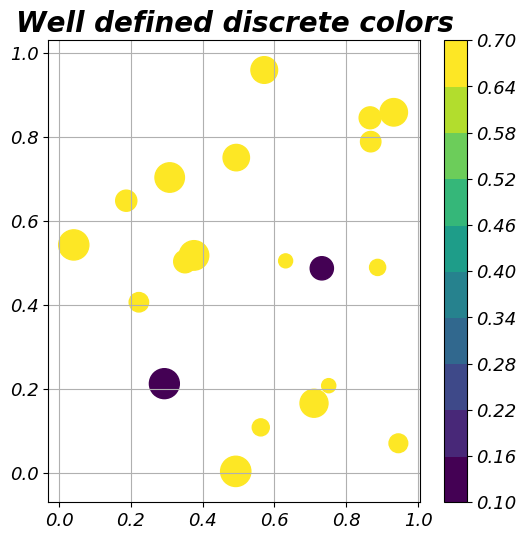

In [441]:
import numpy as np
import matplotlib as mpl
import matplotlib.pylab as plt

fig, ax = plt.subplots(1, 1, figsize=(6, 6))  # setup the plot

x = np.random.rand(20)  # define the data
y = np.random.rand(20)  # define the data
tag = np.random.randint(0, 20, 20)
tag[10:12] = 0  # make sure there are some 0 values to show up as grey


def create_discrete_colorbar(lowerbound, upperbound, number_bins, sequential=True, divergent=False):
    '''
    Creates a colormap with discreet colors from lowerbound to upperbound for number_bins. Choose between sequential or divergent
    Returns cmap, bounds, norm
    call for plotfunction(cmap=cmap,norm=norm)
    plt.colorbar(cmap=cmap,norm=norm,ticks=bounds,boundaries=bounds)
    '''
    
    if sequential:
        cmap = plt.cm.viridis # define the colormap
    if divergent:
        cmap = plt.cm.PiYG
                
    # extract all colors from the cmap
    cmaplist = [cmap(i) for i in range(cmap.N)]

    # create the new map
    cmap = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', cmaplist, cmap.N)

    # define the bins and normalize
    bounds = np.linspace(lowerbound, upperbound, number_bins, endpoint=True)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    return cmap, bounds, norm

cmap, bounds, norm = create_discrete_colorbar(.1,.7, 11)

# make the scatter
scat = ax.scatter(x, y, c=tag, s=np.random.randint(100, 500, 20),
                  cmap=cmap, norm=norm)

# create a second axes for the colorbar
cb = plt.colorbar(scat, cmap=cmap, norm=norm,
    spacing='proportional', ticks=bounds, boundaries=bounds, format='%.2f')

ax.set_title('Well defined discrete colors')